In [1]:
class CFG:
    seed = 4121995
    undersample_no_contact = True
    img_size = 224
    model = 'resnet18'  
    epochs = 20
    train = False
    valid = False
    infer = True
    thresh = 0.64
    dist_thresh = 2
    model_name = 'rgb-bbox-1'

In [2]:
LS = !ls
IS_KAGGLE = 'init.sh' not in LS
IS_KAGGLE

False

In [3]:
import sys

if IS_KAGGLE:
    sys.path.append('/kaggle/input/timm-0-6-9/pytorch-image-models-master')
    CFG.frames_path = ''
    CFG.utils_path = '/kaggle/input/nflutils'
    
    sys.path.insert(0, '../input/nflutils')
    !mkdir -p nflutils
    !cp ../input/nflutils/*.py nflutils/
    
else:
    CFG.frames_path = 'frames/content/work/frames/train'
    CFG.utils_path = 'nflutils'

In [4]:
import numpy as np
import pandas as pd
import matplotlib.pylab as plt

import pickle
import timm

from pathlib import Path

from nflutils.dataprep import *

from tqdm.notebook import tqdm

from sklearn.metrics import matthews_corrcoef

In [5]:
if IS_KAGGLE:
    BASE_DIR = Path("../input/nfl-player-contact-detection")
    OUT_DIR = Path("/kaggle/working/")
else:
    BASE_DIR = Path("nfl-player-contact-detection")
    OUT_DIR = Path("nfl-player-contact-detection/frames")

In [6]:
df_combo = pd.read_parquet(CFG.utils_path+'/df_combo.parquet')
df_combo_with_helmets = pd.read_parquet(CFG.utils_path+'/df_tracking_helmets_below_2.parquet')
df_combo_with_helmets['G_flag'] = np.where(df_combo_with_helmets.nfl_player_id_2 == 'G', 1, 0)

In [7]:
from torch.utils.data import Dataset, DataLoader
import functools

def add_helmets(frame, row):
    frame = frame.copy()
    frame = cv2.rectangle(frame, 
                          (int(row.left_1), int(row.top_1)),
                          (int(row.left_1+row.width_1), int(row.top_1+row.height_1)),
                          (255, 0, 0), 2)
    
    if not np.isnan(row.left_2):
        frame = cv2.rectangle(frame, 
                              (int(row.left_2), int(row.top_2)),
                              (int(row.left_2+row.width_2), int(row.top_2+row.height_2)),
                              (255, 0, 0), 2)
    return frame


@functools.lru_cache(maxsize=500)
def _get_frame(path):
    frame = cv2.imread(path)
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    return frame

def get_frame_path(frame_no, frames_path, game_play, view):
    frame = frame_no if len(str(frame_no)) > 3 else f'0{frame_no}'
    return f'{frames_path}/{game_play}_{view}.mp4_{frame}.jpg'


class NFLFrameTrackingDataset(Dataset):
    def __init__(self, frames_df, transform=None, crop_size=256, helmets=True):
        self.frames_df = frames_df
        self.helmets = helmets
        self.crop_size = crop_size
        self.transform = transform
        self.tracking_cols = ["x_position_1", "y_position_1", "speed_1", "distance_1", "direction_1", "orientation_1", "acceleration_1", "sa_1",
                              "x_position_2", "y_position_2", "speed_2", "distance_2", "direction_2", "orientation_2", "acceleration_2", "sa_2",
                              "distance", "G_flag"]
        
    def __len__(self):
        return len(self.frames_df)
        
    def __getitem__(self, idx):
        row = self.frames_df.iloc[idx]
        frame_path = get_frame_path(int(row.frame), CFG.frames_path, row['game_play'], row['view'])
        frame = self.get_frame(frame_path)
        
        if self.helmets:
            frame = add_helmets(frame, row)
            # frame = add_helmet_heatmap(frame, row)
            
        frame = crop_frame(frame, row.center_x, row.center_y, self.crop_size)
        
        if self.transform is not None:
            frame = self.transform(image=frame)['image']
            
        tracking_data = row[self.tracking_cols].fillna(-1).values.astype(np.float32)
        
        return frame, tracking_data, row.contact
    
    def get_frame(self, path):
        return _get_frame(path)

class NFLFrameDataset(Dataset):
    def __init__(self, frames_df, transform=None, crop_size=256, helmets=True):
        self.frames_df = frames_df
        self.helmets = helmets
        self.crop_size = crop_size
        self.transform = transform
        
    def __len__(self):
        return len(self.frames_df)
        
    def __getitem__(self, idx):
        row = self.frames_df.iloc[idx]
        frame_path = get_frame_path(int(row.frame), CFG.frames_path, row['game_play'], row['view'])
        frame = self.get_frame(frame_path)
        if self.helmets:
            frame = add_helmets(frame, row)
            # frame = add_helmet_heatmap(frame, row)
            
        frame = crop_frame(frame, row.center_x, row.center_y, self.crop_size)
        if self.transform is not None:
            frame = self.transform(image=frame)['image']
        return frame, row.contact
    
    def get_frame(self, path):
        return _get_frame(path)
    
def crop_frame(frame, x, y, size):
    size = size // 2
    
    if y-size < 0:
        min_y = 0
        max_y = min_y + 2*size
        
    elif y+size > 719:
        min_y = 719 - 2*size
        max_y = 719
        
    else:
        min_y = y - size
        max_y = y + size
    
    if x-size < 0:
        min_x = 0
        max_x = min_x + 2*size
        
    elif x+size > 1279:
        min_x = 1279 - 2*size
        max_x = 1279
        
    else:
        min_x = x - size
        max_x = x + size
        
    cropped_frame = frame[int(min_y):int(max_y), 
                          int(min_x):int(max_x), :]
    return cropped_frame
    
def visualize_batch(batch, means, stds):
    """
    Visualize a batch of image data using Matplotlib.
    
    Parameters:
        - batch_tensor (torch.Tensor): A batch of image data in the shape (batch_size, channels, height, width).
        - means (tuple): A tuple of means for each channel in the image data.
        - stds (tuple): A tuple of standard deviations for each channel in the image data.
    """
    # Make a copy of the batch tensor so that we don't modify the original data
    batch_tensor = batch[0].clone()
    
    # De-normalize the data using the means and stds
    batch_tensor = batch_tensor * torch.tensor(stds, dtype=batch_tensor.dtype).view(3, 1, 1) + torch.tensor(means, dtype=batch_tensor.dtype).view(3, 1, 1)
    
    # Convert the data to numpy and transpose it to (batch_size, height, width, channels)
    batch_np = batch_tensor.numpy().transpose(0, 2, 3, 1)
    
    # Plot the images
    plt.figure(figsize=(20, 20))
    for i in range(batch_np.shape[0]):
        plt.subplot(batch_np.shape[0] // 5 + 1, 5, i + 1)
        plt.imshow(batch_np[i])
        plt.title(['no contact', 'contact'][batch[-1][i].item()])
        plt.axis("off")
    plt.show()

In [8]:
class FrameTrackingModel(nn.Module):
    def __init__(self, arch='convnext_tiny', pretrained=True, n_in=3, concat_pool=True, mlp_n=64):
        super(FrameTrackingModel, self).__init__()
        
        model = timm.create_model(arch, pretrained=pretrained, num_classes=0, in_chans=n_in)
        self.body = TimmBody(model, pretrained, n_in=n_in)
        
        self.pool = AdaptiveConcatPool2d() if concat_pool else nn.AdaptiveAvgPool2d(1)
        self.flatten = Flatten()
        
        self.mlp = nn.Sequential(
            nn.Linear(18, mlp_n),
            nn.LayerNorm(mlp_n),
            nn.ReLU(),
            nn.Dropout(0.2)
        )
        
        self.fc = nn.Linear(model.num_features*[1, 2][concat_pool]+mlp_n, 2)
        
    def forward(self, frame, feats):
        # print(frame.shape, feats.shape)
        x1 = self.body(frame)
        x1 = self.pool(x1)
        x1 = self.flatten(x1)
        x2 = self.mlp(feats)
        # print(x1.shape, x2.shape)
        return self.fc(torch.cat([x1, x2], dim=1))

### rgb-bbox-simple-model-reshuffle-and-offset-pp-sep-1

In [11]:
from nflutils.validation import *

In [9]:
name = 'rgb-bbox-simple-model-reshuffle-and-offset-pp-sep-1'
val_df = pd.read_parquet(f'{name}.parquet')

In [12]:
matthews_corrcoef(val_df.contact, val_df.contact_pred > 0.5)

0.6581873798653285

In [25]:
ws = list(np.arange(10, 25, 1))
tmp_df = smooth_predictions(val_df, center=True, ws=ws)
tmp_df.to_parquet(f'{name}-rolling.parquet', index=False)

  0%|          | 0/4349 [00:00<?, ?it/s]

In [26]:
tmp_df = pd.read_parquet(f'{name}-rolling.parquet')

Supposedly this model can do better.

#### Player to player

In [20]:
np.linspace(0.5, 0.5, 1)

array([0.5])

In [27]:
tmp_df_p = tmp_df[tmp_df.left_2.notnull()].copy()
df_combo_p = df_combo[df_combo.nfl_player_id_2 != "G"]


cols = tmp_df.columns[tmp_df.columns.str.contains('rolling')]

cols_results = []

for col in tqdm(cols):
        
    for t in np.linspace(0.4, 0.6, 20):
        
        result = {}
    
        result['col'] = col
        
        result['thresh'] = t

        result['full'] = matthews_corrcoef(tmp_df_p["contact"], (tmp_df_p[col] > t).astype(int))

        agg_dict = {col: 'first' for col in val_df.columns}
        agg_dict[col] = 'mean'

        tmp_df_2 = tmp_df_p.groupby('contact_id').agg(agg_dict)

        result['average'] = matthews_corrcoef(tmp_df_2["contact"], (tmp_df_2[col] > t).astype(int))
        
        sub = tmp_df_p.copy()

        sub['contact_pred_rolling'] = sub[col]
        sub['thresh'] = t

        sub = merge_combo_val(df_combo_p, sub, pred_col='contact_pred_rolling')
        
        for dist in np.linspace(0.5, 0.5, 1):
            result = result.copy()
            result['distance'] = dist
            result['final'] = get_matthews_corrcoef(sub, pred_col='contact_pred_rolling', dist=dist)
            cols_results.append(result)

  0%|          | 0/15 [00:00<?, ?it/s]

In [28]:
player_results = pd.DataFrame(cols_results).sort_values('final', ascending=False)

In [29]:
player_results.to_csv(f'{name}-player-configs.csv', index=False)

In [30]:
player_results.iloc[:10]

,col,thresh,full,average,distance,final
89,contact_pred_rolling_14,0.494737,0.673364,0.696203,0.5,0.751627
211,contact_pred_rolling_20,0.515789,0.679379,0.697852,0.5,0.751554
126,contact_pred_rolling_16,0.463158,0.672998,0.694080,0.5,0.751549
49,contact_pred_rolling_12,0.494737,0.671912,0.695992,0.5,0.751490
8,contact_pred_rolling_10,0.484211,0.670086,0.695331,0.5,0.751482
10,contact_pred_rolling_10,0.505263,0.670757,0.696513,0.5,0.751346
167,contact_pred_rolling_18,0.473684,0.675291,0.694462,0.5,0.751261
50,contact_pred_rolling_12,0.505263,0.672225,0.696468,0.5,0.751252
48,contact_pred_rolling_12,0.484211,0.671757,0.695040,0.5,0.751249
127,contact_pred_rolling_16,0.473684,0.674277,0.694394,0.5,0.751233


In [34]:
name = 'rgb-bbox-simple-model-with-reshuffle-and-offset-ground-sep-bigger'
tmp_df2 = pd.read_parquet(f'{name}-rolling.parquet')

In [35]:
tmp_df_g = tmp_df2[tmp_df2.nfl_player_id_2 == "G"].copy()
tmp_df_p = tmp_df[tmp_df.nfl_player_id_2 != "G"].copy()

In [36]:
tmp_df_g['contact_pred_rolling'] = tmp_df_g.contact_pred_rolling_56
tmp_df_g['thresh'] = 0.4

In [37]:
tmp_df_p['contact_pred_rolling'] = tmp_df_p.contact_pred_rolling_14
tmp_df_p['thresh'] = 0.494

In [38]:
cols = ['contact_id', 'distance', 'thresh', 'contact_pred_rolling', 'game_play', 'contact_pred']
sub_df = pd.concat([tmp_df_g[cols], tmp_df_p[cols]])

In [39]:
sub = merge_combo_val(df_combo, sub_df, pred_col='contact_pred_rolling')
get_matthews_corrcoef(sub, pred_col='contact_pred_rolling', dist=0.2)

0.7621704582889398

### rgb-bbox-tracking-pp-simple-model-5

In [9]:
from nflutils.validation import *

#### Compare the results with biggest model so far

In [11]:
val_df = pd.read_parquet('rgb-bbox-tracking-simple-model-with-reshuffle-and-offset-even-bigger_5.parquet')
val_df = val_df.query('(290 - frame) % 6 == 0')

matthews_corrcoef(val_df.contact, val_df.contact_pred > 0.5)

0.647159803551888

#### Create predictions

In [12]:
kf_dict = pickle.load(open('kf_dict', 'rb'))
val_games = kf_dict[0]['val_games']

val_df = df_combo_with_helmets.query('game_play in @val_games').copy()
val_df = val_df[(val_df.left_2.notnull()) | (val_df.nfl_player_id_2 == "G")].copy()
val_df['frame'] = val_df['frame'].astype(int)

In [31]:
import albumentations as A
from albumentations.pytorch import ToTensorV2


set_seed(42, True)
name = 'rgb-bbox-tracking-pp-simple-model-5'
seed = 42
bs = 64
channels = 3
 
means = [0.485, 0.456, 0.406]
stds = [0.229, 0.224, 0.225]


val_transform = A.Compose(
    [
        A.Normalize(mean=means[:channels], std=stds[:channels]),
        ToTensorV2(),
    ]
)

test_ds = NFLFrameTrackingDataset(val_df, transform=val_transform, crop_size=256)

test_loader = DataLoader(
    test_ds, batch_size=bs, shuffle=False, num_workers=8, pin_memory=True,
)


data = DataLoaders(test_loader, test_loader)

model = FrameTrackingModel('convnext_tiny')
learn = Learner(data, model, CrossEntropyLossFlat(),
                metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
               ).to_fp16()

learn = learn.load(name)

/usr/local/lib/python3.9/dist-packages/fastai/learner.py:59: UserWarning: Saved filed doesn't contain an optimizer state.
  elif with_opt: warn("Saved filed doesn't contain an optimizer state.")


In [32]:
torch.save(learn.model, f'nflutils/{name}.pkl')

In [ ]:
preds, _ = learn.get_preds(dl=test_loader)

In [ ]:
val_df['contact_pred'] = preds[:, 1]
val_df['loss'] = losses

val_df.to_parquet(f'{name}.parquet', index=False)

In [ ]:
matthews_corrcoef(val_df.contact, val_df.contact_pred > 0.5)

In [ ]:
val_df_6 = val_df.query('(290 - frame) % 6 == 0')

matthews_corrcoef(val_df_6.contact, val_df_6.contact_pred > 0.5)

In [21]:
from nflutils.validation import *

### Test all configs

In [22]:
ws = list(np.arange(1, 50, 1))
tmp_df = smooth_predictions(val_df, center=True, ws=ws)
tmp_df.to_parquet(f'{name}-rolling.parquet', index=False)

  0%|          | 0/6403 [00:00<?, ?it/s]

In [23]:
tmp_df = pd.read_parquet(f'{name}-rolling.parquet')

Supposedly this model can do better.

#### Player to player

In [24]:
tmp_df_p = tmp_df[tmp_df.nfl_player_id_2 != "G"].copy()
df_combo_p = df_combo[df_combo.nfl_player_id_2 != "G"]


cols = tmp_df.columns[tmp_df.columns.str.contains('rolling')]

cols_results = []

for col in tqdm(cols):
        
    for t in np.linspace(0.6, 0.9, 10):
        
        result = {}
    
        result['col'] = col
        
        result['thresh'] = t

        result['full'] = matthews_corrcoef(tmp_df_p["contact"], (tmp_df_p[col] > t).astype(int))

        agg_dict = {col: 'first' for col in val_df.columns}
        agg_dict[col] = 'mean'

        tmp_df_2 = tmp_df_p.groupby('contact_id').agg(agg_dict)

        result['average'] = matthews_corrcoef(tmp_df_2["contact"], (tmp_df_2[col] > t).astype(int))
        
        sub = tmp_df_p.copy()

        sub['contact_pred_rolling'] = sub[col]
        sub['thresh'] = t

        sub = merge_combo_val(df_combo_p, sub, pred_col='contact_pred_rolling')
        
        for dist in np.linspace(0, 1, 10):
            result = result.copy()
            result['distance'] = dist
            result['final'] = get_matthews_corrcoef(sub, pred_col='contact_pred_rolling', dist=dist)
            cols_results.append(result)

  0%|          | 0/49 [00:00<?, ?it/s]

In [25]:
player_results = pd.DataFrame(cols_results).sort_values('final', ascending=False)

In [26]:
player_results.to_csv(f'{name}-player-configs.csv', index=False)

In [27]:
player_results.iloc[:10]

,col,thresh,full,average,distance,final
1002,contact_pred_rolling_11,0.6,0.646112,0.653733,0.222222,0.703753
1102,contact_pred_rolling_12,0.6,0.646724,0.653868,0.222222,0.703739
902,contact_pred_rolling_10,0.6,0.646049,0.653447,0.222222,0.703642
802,contact_pred_rolling_9,0.6,0.644384,0.653040,0.222222,0.703467
1001,contact_pred_rolling_11,0.6,0.646112,0.653733,0.111111,0.703423
1003,contact_pred_rolling_11,0.6,0.646112,0.653733,0.333333,0.703419
1101,contact_pred_rolling_12,0.6,0.646724,0.653868,0.111111,0.703410
1103,contact_pred_rolling_12,0.6,0.646724,0.653868,0.333333,0.703404
1004,contact_pred_rolling_11,0.6,0.646112,0.653733,0.444444,0.703376
1104,contact_pred_rolling_12,0.6,0.646724,0.653868,0.444444,0.703360


### Test submission

In [28]:
name = 'rgb-bbox-1'
tmp_df2 = pd.read_parquet(f'{name}-rolling.parquet')

FileNotFoundError: [Errno 2] No such file or directory: 'rgb-bbox-1-rolling.parquet'

In [ ]:
tmp_df_g = tmp_df2[tmp_df2.nfl_player_id_2 == "G"].copy()
tmp_df_p = tmp_df[tmp_df.nfl_player_id_2 != "G"].copy()

In [ ]:
tmp_df_g['contact_pred_rolling'] = tmp_df_g.contact_pred_rolling_60
tmp_df_g['thresh'] = 0.43333

In [ ]:
tmp_df_p['contact_pred_rolling'] = tmp_df_p.contact_pred_rolling_18
tmp_df_p['thresh'] = 0.7

In [ ]:
cols = ['contact_id', 'distance', 'thresh', 'contact_pred_rolling', 'game_play', 'contact_pred']
sub_df = pd.concat([tmp_df_g[cols], tmp_df_p[cols]])

In [ ]:
sub = merge_combo_val(df_combo, sub_df, pred_col='contact_pred_rolling')
get_matthews_corrcoef(sub, pred_col='contact_pred_rolling', dist=0.2)

### rgb-bbox-simple-model-with-reshuffle-and-offset

In [9]:
kf_dict = pickle.load(open('kf_dict', 'rb'))
val_games = kf_dict[0]['val_games']

val_df = df_combo_with_helmets.query('game_play in @val_games').copy()
val_df = val_df[(val_df.left_2.notnull()) | (val_df.nfl_player_id_2 == "G")].copy()
val_df['frame'] = val_df['frame'].astype(int)

In [16]:
import albumentations as A
from albumentations.pytorch import ToTensorV2


set_seed(42, True)
name = 'rgb-bbox-simple-model-with-reshuffle-and-offset'
seed = 42
bs = 64
channels = 3
 
means = [0.485, 0.456, 0.406]
stds = [0.229, 0.224, 0.225]


val_transform = A.Compose(
    [
        A.Normalize(mean=means[:channels], std=stds[:channels]),
        ToTensorV2(),
    ]
)

test_ds = NFLFrameDataset(val_df, transform=val_transform, crop_size=256)

test_loader = DataLoader(
    test_ds, batch_size=bs, shuffle=False, num_workers=8, pin_memory=True,
)


data = DataLoaders(test_loader, test_loader)

model, model_info = create_timm_model('convnext_tiny', 2)
learn = Learner(data, model, CrossEntropyLossFlat(),
                metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
               ).to_fp16()

learn = learn.load(name)

In [15]:
torch.save(learn.model, f'nflutils/{name[:-2]}.pkl')

In [17]:
preds, _, losses = learn.get_preds(dl=test_loader, with_loss=True)

In [18]:
val_df['contact_pred'] = preds[:, 1]
val_df['loss'] = losses

val_df.to_parquet(f'{name}.parquet', index=False)

In [19]:
from nflutils.validation import *

### Test all configs

In [21]:
ws = list(np.arange(15, 75, 1))
tmp_df = smooth_predictions(val_df, center=True, ws=ws)
tmp_df.to_parquet(f'{name}-rolling.parquet', index=False)

  0%|          | 0/6403 [00:00<?, ?it/s]

In [9]:
name = 'rgb-bbox-simple-model-with-reshuffle-and-offset'
tmp_df = pd.read_parquet(f'{name}-rolling.parquet')

#### Player to player

In [28]:
tmp_df_p = tmp_df[tmp_df.nfl_player_id_2 != "G"].copy()
df_combo_p = df_combo[df_combo.nfl_player_id_2 != "G"]


cols = tmp_df.columns[tmp_df.columns.str.contains('rolling')]

cols_results = []

for col in tqdm(cols):
        
    for t in np.linspace(0.6, 0.9, 10):
        
        result = {}
    
        result['col'] = col
        
        result['thresh'] = t

        result['full'] = matthews_corrcoef(tmp_df_p["contact"], (tmp_df_p[col] > t).astype(int))

        agg_dict = {col: 'first' for col in val_df.columns}
        agg_dict[col] = 'mean'

        tmp_df_2 = tmp_df_p.groupby('contact_id').agg(agg_dict)

        result['average'] = matthews_corrcoef(tmp_df_2["contact"], (tmp_df_2[col] > t).astype(int))
        
        sub = tmp_df_p.copy()

        sub['contact_pred_rolling'] = sub[col]
        sub['thresh'] = t

        sub = merge_combo_val(df_combo_p, sub, pred_col='contact_pred_rolling')
        
        for dist in np.linspace(0, 1, 10):
            result = result.copy()
            result['distance'] = dist
            result['final'] = get_matthews_corrcoef(sub, pred_col='contact_pred_rolling', dist=dist)
            cols_results.append(result)

  0%|          | 0/20 [00:00<?, ?it/s]

In [29]:
player_results = pd.DataFrame(cols_results).sort_values('final', ascending=False)

In [30]:
player_results.to_csv(f'{name}-player-configs.csv', index=False)

In [31]:
player_results.iloc[:10]

,col,thresh,full,average,distance,final
755,contact_pred_rolling_22,0.766667,0.666244,0.692258,0.555556,0.750374
752,contact_pred_rolling_22,0.766667,0.666244,0.692258,0.222222,0.750153
655,contact_pred_rolling_21,0.766667,0.665781,0.691577,0.555556,0.750055
754,contact_pred_rolling_22,0.766667,0.666244,0.692258,0.444444,0.750020
753,contact_pred_rolling_22,0.766667,0.666244,0.692258,0.333333,0.749957
855,contact_pred_rolling_23,0.766667,0.667348,0.691908,0.555556,0.749947
665,contact_pred_rolling_21,0.800000,0.669295,0.694208,0.555556,0.749896
751,contact_pred_rolling_22,0.766667,0.666244,0.692258,0.111111,0.749838
652,contact_pred_rolling_21,0.766667,0.665781,0.691577,0.222222,0.749822
662,contact_pred_rolling_21,0.800000,0.669295,0.694208,0.222222,0.749776


#### Player to ground

In [26]:
tmp_df_g = tmp_df[tmp_df.nfl_player_id_2 == "G"].copy()
df_combo_g = df_combo[df_combo.nfl_player_id_2 == "G"]

cols = tmp_df.columns[tmp_df.columns.str.contains('rolling')]

cols_results = []

for col in tqdm(cols):
        
    for t in np.linspace(0.3, 0.8, 20):
        
        result = {}
    
        result['col'] = col
        
        result['thresh'] = t

        result['full'] = matthews_corrcoef(tmp_df_g["contact"], (tmp_df_g[col] > t).astype(int))

        agg_dict = {col: 'first' for col in val_df.columns}
        agg_dict[col] = 'mean'

        tmp_df_2 = tmp_df_g.groupby('contact_id').agg(agg_dict)

        result['average'] = matthews_corrcoef(tmp_df_2["contact"], (tmp_df_2[col] > t).astype(int))
        
        sub = tmp_df_g.copy()

        sub['contact_pred_rolling'] = sub[col]
        sub['thresh'] = t

        sub = merge_combo_val(df_combo_g, sub, pred_col='contact_pred_rolling')
        
        result['final'] = get_matthews_corrcoef(sub, pred_col='contact_pred_rolling', dist=1)
        cols_results.append(result)

  0%|          | 0/60 [00:00<?, ?it/s]

In [ ]:
ground_results = pd.DataFrame(cols_results).sort_values('final', ascending=False)

In [ ]:
ground_results.to_csv(f'{name}-ground-configs.csv', index=False)

In [ ]:
ground_results.iloc[:10]

,col,thresh,full,average,final
900,contact_pred_rolling_60,0.300000,0.769008,0.812274,0.789930
860,contact_pred_rolling_58,0.300000,0.770169,0.811662,0.789335
941,contact_pred_rolling_62,0.326316,0.768027,0.811513,0.789213
820,contact_pred_rolling_56,0.300000,0.772109,0.811522,0.789199
1021,contact_pred_rolling_66,0.326316,0.767634,0.811228,0.788937
961,contact_pred_rolling_63,0.326316,0.766070,0.810831,0.788551
740,contact_pred_rolling_52,0.300000,0.771032,0.810804,0.788506
840,contact_pred_rolling_57,0.300000,0.770252,0.810781,0.788481
981,contact_pred_rolling_64,0.326316,0.767492,0.810700,0.788425
920,contact_pred_rolling_61,0.300000,0.767346,0.810718,0.788421


#### Validation score to compare with submission

##### With tracking

In [16]:
from nflutils.validation import *

In [10]:
name = 'rgb-bbox-tracking-simple-model-with-reshuffle-and-offset-even-bigger_5'
tmp_df2 = pd.read_parquet(f'{name}-rolling.parquet')

In [11]:
tmp_df_g = tmp_df[tmp_df.nfl_player_id_2 == "G"].copy()
tmp_df_p = tmp_df2[tmp_df2.nfl_player_id_2 != "G"].copy()

In [12]:
tmp_df_g['contact_pred_rolling'] = tmp_df_g.contact_pred_rolling_60
tmp_df_g['thresh'] = 0.3

In [13]:
tmp_df_p['contact_pred_rolling'] = tmp_df_p.contact_pred_rolling_22
tmp_df_p['thresh'] = 0.766667

In [14]:
cols = ['contact_id', 'distance', 'thresh', 'contact_pred_rolling', 'game_play', 'contact_pred']
sub_df = pd.concat([tmp_df_g[cols], tmp_df_p[cols]])

In [18]:
sub = merge_combo_val(df_combo, sub_df, pred_col='contact_pred_rolling')
get_matthews_corrcoef(sub, pred_col='contact_pred_rolling', dist=0.2)

0.7593806490628934

### rgb-bbox-tracking-simple-model-with-reshuffle-and-offset-even-bigger

In [9]:
kf_dict = pickle.load(open('kf_dict', 'rb'))
val_games = kf_dict[0]['val_games']

val_df = df_combo_with_helmets.query('game_play in @val_games').copy()
val_df = val_df[(val_df.left_2.notnull()) | (val_df.nfl_player_id_2 == "G")].copy()
val_df['frame'] = val_df['frame'].astype(int)

In [14]:
import albumentations as A
from albumentations.pytorch import ToTensorV2


set_seed(42, True)
name = 'rgb-bbox-tracking-simple-model-with-reshuffle-and-offset-even-bigger_5'
seed = 42
bs = 64
channels = 3
 
means = [0.485, 0.456, 0.406]
stds = [0.229, 0.224, 0.225]


val_transform = A.Compose(
    [
        A.Normalize(mean=means[:channels], std=stds[:channels]),
        ToTensorV2(),
    ]
)

test_ds = NFLFrameTrackingDataset(val_df, transform=val_transform, crop_size=256)

test_loader = DataLoader(
    test_ds, batch_size=bs, shuffle=False, num_workers=8, pin_memory=True,
)


data = DataLoaders(test_loader, test_loader)

model = FrameTrackingModel('convnext_base')
learn = Learner(data, model, CrossEntropyLossFlat(),
                metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
               ).to_fp16()

learn = learn.load(name)

Downloading: "https://dl.fbaipublicfiles.com/convnext/convnext_base_1k_224_ema.pth" to /root/.cache/torch/hub/checkpoints/convnext_base_1k_224_ema.pth


In [15]:
torch.save(learn.model, f'nflutils/{name[:-2]}.pkl')

In [16]:
preds, _, losses = learn.get_preds(dl=test_loader, with_loss=True)

In [17]:
val_df['contact_pred'] = preds[:, 1]
val_df['loss'] = losses

val_df.to_parquet(f'{name}.parquet', index=False)

In [18]:
from nflutils.validation import *

### Test all configs

In [19]:
ws = list(np.arange(15, 25, 1)) + list(np.arange(65, 75, 1))
tmp_df = smooth_predictions(val_df, center=True, ws=ws)
tmp_df.to_parquet(f'{name}-rolling.parquet', index=False)

  0%|          | 0/6403 [00:00<?, ?it/s]

In [23]:
name = 'rgb-bbox-tracking-simple-model-with-reshuffle-and-offset-even-bigger_5'
tmp_df = pd.read_parquet(f'{name}-rolling.parquet')

#### Player to player

In [28]:
tmp_df_p = tmp_df[tmp_df.nfl_player_id_2 != "G"].copy()
df_combo_p = df_combo[df_combo.nfl_player_id_2 != "G"]


cols = tmp_df.columns[tmp_df.columns.str.contains('rolling')]

cols_results = []

for col in tqdm(cols):
        
    for t in np.linspace(0.6, 0.9, 10):
        
        result = {}
    
        result['col'] = col
        
        result['thresh'] = t

        result['full'] = matthews_corrcoef(tmp_df_p["contact"], (tmp_df_p[col] > t).astype(int))

        agg_dict = {col: 'first' for col in val_df.columns}
        agg_dict[col] = 'mean'

        tmp_df_2 = tmp_df_p.groupby('contact_id').agg(agg_dict)

        result['average'] = matthews_corrcoef(tmp_df_2["contact"], (tmp_df_2[col] > t).astype(int))
        
        sub = tmp_df_p.copy()

        sub['contact_pred_rolling'] = sub[col]
        sub['thresh'] = t

        sub = merge_combo_val(df_combo_p, sub, pred_col='contact_pred_rolling')
        
        for dist in np.linspace(0, 1, 10):
            result = result.copy()
            result['distance'] = dist
            result['final'] = get_matthews_corrcoef(sub, pred_col='contact_pred_rolling', dist=dist)
            cols_results.append(result)

  0%|          | 0/20 [00:00<?, ?it/s]

In [29]:
player_results = pd.DataFrame(cols_results).sort_values('final', ascending=False)

In [30]:
player_results.to_csv(f'{name}-player-configs.csv', index=False)

In [31]:
player_results.iloc[:10]

,col,thresh,full,average,distance,final
755,contact_pred_rolling_22,0.766667,0.666244,0.692258,0.555556,0.750374
752,contact_pred_rolling_22,0.766667,0.666244,0.692258,0.222222,0.750153
655,contact_pred_rolling_21,0.766667,0.665781,0.691577,0.555556,0.750055
754,contact_pred_rolling_22,0.766667,0.666244,0.692258,0.444444,0.750020
753,contact_pred_rolling_22,0.766667,0.666244,0.692258,0.333333,0.749957
855,contact_pred_rolling_23,0.766667,0.667348,0.691908,0.555556,0.749947
665,contact_pred_rolling_21,0.800000,0.669295,0.694208,0.555556,0.749896
751,contact_pred_rolling_22,0.766667,0.666244,0.692258,0.111111,0.749838
652,contact_pred_rolling_21,0.766667,0.665781,0.691577,0.222222,0.749822
662,contact_pred_rolling_21,0.800000,0.669295,0.694208,0.222222,0.749776


#### Player to ground

In [32]:
tmp_df_g = tmp_df[tmp_df.nfl_player_id_2 == "G"].copy()
df_combo_g = df_combo[df_combo.nfl_player_id_2 == "G"]

cols = tmp_df.columns[tmp_df.columns.str.contains('rolling')]

cols_results = []

for col in tqdm(cols):
        
    for t in np.linspace(0.4, 0.7, 10):
        
        result = {}
    
        result['col'] = col
        
        result['thresh'] = t

        result['full'] = matthews_corrcoef(tmp_df_g["contact"], (tmp_df_g[col] > t).astype(int))

        agg_dict = {col: 'first' for col in val_df.columns}
        agg_dict[col] = 'mean'

        tmp_df_2 = tmp_df_g.groupby('contact_id').agg(agg_dict)

        result['average'] = matthews_corrcoef(tmp_df_2["contact"], (tmp_df_2[col] > t).astype(int))
        
        sub = tmp_df_g.copy()

        sub['contact_pred_rolling'] = sub[col]
        sub['thresh'] = t

        sub = merge_combo_val(df_combo_g, sub, pred_col='contact_pred_rolling')
        
        result['final'] = get_matthews_corrcoef(sub, pred_col='contact_pred_rolling', dist=1)
        cols_results.append(result)

  0%|          | 0/20 [00:00<?, ?it/s]

In [33]:
ground_results = pd.DataFrame(cols_results).sort_values('final', ascending=False)

In [34]:
ground_results.to_csv(f'{name}-ground-configs.csv', index=False)

In [35]:
ground_results.iloc[:10]

,col,thresh,full,average,final
113,contact_pred_rolling_66,0.500000,0.768105,0.581611,0.785115
173,contact_pred_rolling_72,0.500000,0.769054,0.576164,0.783875
123,contact_pred_rolling_67,0.500000,0.766481,0.580816,0.783559
153,contact_pred_rolling_70,0.500000,0.766579,0.577591,0.783501
101,contact_pred_rolling_65,0.433333,0.759803,0.549343,0.783265
112,contact_pred_rolling_66,0.466667,0.765140,0.566326,0.783165
102,contact_pred_rolling_65,0.466667,0.763377,0.566883,0.782986
121,contact_pred_rolling_67,0.433333,0.759677,0.546899,0.782823
111,contact_pred_rolling_66,0.433333,0.760855,0.548049,0.782715
141,contact_pred_rolling_69,0.433333,0.758828,0.546459,0.782564


#### Validation score to compare with submission

In [14]:
tmp_df = pd.read_parquet(f'{name}-rolling.parquet')

In [36]:
tmp_df_g = tmp_df[tmp_df.nfl_player_id_2 == "G"].copy()
tmp_df_p = tmp_df[tmp_df.nfl_player_id_2 != "G"].copy()

In [37]:
tmp_df_g['contact_pred_rolling'] = tmp_df_g.contact_pred_rolling_66
tmp_df_g['thresh'] = 0.5

In [38]:
tmp_df_p['contact_pred_rolling'] = tmp_df_p.contact_pred_rolling_22
tmp_df_p['thresh'] = 0.766667

In [39]:
cols = ['contact_id', 'distance', 'thresh', 'contact_pred_rolling', 'game_play', 'contact_pred']
sub_df = pd.concat([tmp_df_g[cols], tmp_df_p[cols]])

In [40]:
sub = merge_combo_val(df_combo, sub_df, pred_col='contact_pred_rolling')
get_matthews_corrcoef(sub, pred_col='contact_pred_rolling', dist=0.5)

0.7585061444756415

### rgb-bbox-tracking-simple-model-with-reshuffle-and-offset

In [10]:
kf_dict = pickle.load(open('kf_dict', 'rb'))
val_games = kf_dict[0]['val_games']

val_df = df_combo_with_helmets.query('game_play in @val_games').copy()
val_df = val_df[(val_df.left_2.notnull()) | (val_df.nfl_player_id_2 == "G")].copy()
val_df['frame'] = val_df['frame'].astype(int)

In [11]:
import albumentations as A
from albumentations.pytorch import ToTensorV2


set_seed(42, True)
name = 'rgb-bbox-tracking-simple-model-with-reshuffle-and-offset'
seed = 42
bs = 64
channels = 3
 
means = [0.485, 0.456, 0.406]
stds = [0.229, 0.224, 0.225]


val_transform = A.Compose(
    [
        A.Normalize(mean=means[:channels], std=stds[:channels]),
        ToTensorV2(),
    ]
)

test_ds = NFLFrameTrackingDataset(val_df, transform=val_transform, crop_size=256)

test_loader = DataLoader(
    test_ds, batch_size=bs, shuffle=False, num_workers=8, pin_memory=True,
)


data = DataLoaders(test_loader, test_loader)

model = FrameTrackingModel()
learn = Learner(data, model, CrossEntropyLossFlat(),
                metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
               ).to_fp16()

learn = learn.load(name)

Downloading: "https://dl.fbaipublicfiles.com/convnext/convnext_tiny_1k_224_ema.pth" to /root/.cache/torch/hub/checkpoints/convnext_tiny_1k_224_ema.pth
/usr/local/lib/python3.9/dist-packages/fastai/learner.py:59: UserWarning: Saved filed doesn't contain an optimizer state.
  elif with_opt: warn("Saved filed doesn't contain an optimizer state.")


In [11]:
preds, _, losses = learn.get_preds(dl=test_loader, with_loss=True)

In [12]:
val_df['contact_pred'] = preds[:, 1]
val_df['loss'] = losses

val_df.to_parquet(f'{name}.parquet', index=False)

In [12]:
def smooth_predictions(val_df, center, ws):
    val_df_new = pd.DataFrame()
    for group, group_df in tqdm(val_df.groupby(['game_play', 'nfl_player_id_1', 'nfl_player_id_2', 'view'])):
        group_df = group_df.sort_values('frame').copy()
        for w in ws: 
            group_df[f'contact_pred_rolling_{w}'] = group_df.contact_pred.rolling(w, center=center).mean().bfill().ffill().fillna(0)
        val_df_new = pd.concat([val_df_new, group_df])
    return val_df_new

def merge_combo_val(df_combo, val_df, pred_col='contact_pred_rolling'):
    val_dist = df_combo[df_combo.game_play.isin(val_df.game_play.unique())].copy()

    val_dist["distance"] = val_dist["distance"].fillna(99)  # Fill player to ground with 9    
    val_dist_agg = val_dist.merge(val_df.groupby('contact_id', as_index=False)[pred_col].mean(), how='left', on='contact_id')
    val_dist_agg = val_dist_agg.merge(val_df.groupby('contact_id', as_index=False)['thresh'].first(), how='left', on='contact_id')
    
    if pred_col != 'contact_pred':
        val_dist_agg = val_dist_agg.merge(val_df.groupby('contact_id', as_index=False)['contact_pred'].mean(), how='left', on='contact_id')
        
    return val_dist_agg

def get_matthews_corrcoef(val_dist_agg, pred_col='contact_pred_rolling', dist=1):
    out = np.where(val_dist_agg['contact_pred'].isna(),
                   val_dist_agg['distance'] <= dist, 
                   val_dist_agg[pred_col] > val_dist_agg['thresh']).astype(int)
    
    return matthews_corrcoef(val_dist_agg['contact'], out)

def test_submission(val_df, w_p, w_g, thresh_p, thresh_g, dist=1):
    sub = val_df.copy()
    sub = sub[(sub.left_2.notnull()) | (sub.nfl_player_id_2 == "G")]

    sub = smooth_predictions(sub, True, ws=[w_p, w_g])
    sub['contact_pred_rolling'] = np.where(sub.nfl_player_id_2.notnull(), sub[f'contact_pred_rolling_{w_p}'], sub[f'contact_pred_rolling_{w_g}'])
    sub['thresh'] = np.where(sub.nfl_player_id_2.notnull(), thresh_p, thresh_g)
    
    sub = merge_combo_val(df_combo, sub, pred_col='contact_pred_rolling')
    return get_matthews_corrcoef(sub, pred_col='contact_pred_rolling', dist=dist)

In [17]:
test_submission(val_df, 19, 58, 0.67, 0.45)

  0%|          | 0/6403 [00:00<?, ?it/s]

0.7202111418735931

### Test all configs

In [18]:
tmp_df = smooth_predictions(val_df, center=True, ws=np.arange(3, 70, 3))
tmp_df.to_parquet(f'{name}-rolling.parquet', index=False)

  0%|          | 0/6403 [00:00<?, ?it/s]

#### Player to player

In [44]:
tmp_df_p = tmp_df[tmp_df.nfl_player_id_2 != "G"].copy()
df_combo_p = df_combo[df_combo.nfl_player_id_2 != "G"]


cols = tmp_df.columns[tmp_df.columns.str.contains('rolling')]

cols_results = []

for col in tqdm(cols):
        
    for t in np.linspace(0.4, 0.7, 5):
        
        result = {}
    
        result['col'] = col
        
        result['thresh'] = t

        result['full'] = matthews_corrcoef(tmp_df_p["contact"], (tmp_df_p[col] > t).astype(int))

        agg_dict = {col: 'first' for col in val_df.columns}
        agg_dict[col] = 'mean'

        tmp_df_2 = tmp_df_p.groupby('contact_id').agg(agg_dict)

        result['average'] = matthews_corrcoef(tmp_df_2["contact"], (tmp_df_2[col] > t).astype(int))
        
        sub = tmp_df_p.copy()

        sub['contact_pred_rolling'] = sub[col]
        sub['thresh'] = t

        sub = merge_combo_val(df_combo_p, sub, pred_col='contact_pred_rolling')
        
        for dist in np.linspace(0, 1, 5):
            result['distance'] = dist
            result['final'] = get_matthews_corrcoef(sub, pred_col='contact_pred_rolling', dist=dist)
            cols_results.append(result)

  0%|          | 0/23 [00:00<?, ?it/s]

In [45]:
player_results = pd.DataFrame(cols_results).sort_values('final', ascending=False)

In [46]:
player_results.to_csv(f'{name}-player-configs.csv', index=False)

In [47]:
player_results.iloc[:10]

,col,thresh,full,average,distance,final
145,contact_pred_rolling_18,0.7,0.678623,0.689333,1.0,0.732052
146,contact_pred_rolling_18,0.7,0.678623,0.689333,1.0,0.732052
147,contact_pred_rolling_18,0.7,0.678623,0.689333,1.0,0.732052
148,contact_pred_rolling_18,0.7,0.678623,0.689333,1.0,0.732052
149,contact_pred_rolling_18,0.7,0.678623,0.689333,1.0,0.732052
199,contact_pred_rolling_24,0.7,0.681858,0.689923,1.0,0.731557
195,contact_pred_rolling_24,0.7,0.681858,0.689923,1.0,0.731557
196,contact_pred_rolling_24,0.7,0.681858,0.689923,1.0,0.731557
197,contact_pred_rolling_24,0.7,0.681858,0.689923,1.0,0.731557
198,contact_pred_rolling_24,0.7,0.681858,0.689923,1.0,0.731557


#### Player to ground

In [ ]:
tmp_df_g = tmp_df[tmp_df.nfl_player_id_2 == "G"].copy()
df_combo_g = df_combo[df_combo.nfl_player_id_2 == "G"]

cols = tmp_df.columns[tmp_df.columns.str.contains('rolling')]

cols_results = []

for col in tqdm(cols):
        
    for t in np.linspace(0.4, 0.7, 10):
        
        result = {}
    
        result['col'] = col
        
        result['thresh'] = t

        result['full'] = matthews_corrcoef(tmp_df_g["contact"], (tmp_df_g[col] > t).astype(int))

        agg_dict = {col: 'first' for col in val_df.columns}
        agg_dict[col] = 'mean'

        tmp_df_2 = tmp_df_p.groupby('contact_id').agg(agg_dict)

        result['average'] = matthews_corrcoef(tmp_df_2["contact"], (tmp_df_2[col] > t).astype(int))
        
        sub = tmp_df_g.copy()

        sub['contact_pred_rolling'] = sub[col]
        sub['thresh'] = t

        sub = merge_combo_val(df_combo_g, sub, pred_col='contact_pred_rolling')
        
        result['final'] = get_matthews_corrcoef(sub, pred_col='contact_pred_rolling', dist=dist)
        cols_results.append(result)

  0%|          | 0/23 [00:00<?, ?it/s]

In [ ]:
ground_results = pd.DataFrame(cols_results).sort_values('final', ascending=False)

In [ ]:
ground_results.to_csv(f'{name}-ground-configs.csv', index=False)

In [ ]:
ground_results.iloc[:10]

#### Validation score to compare with submission

In [14]:
tmp_df = pd.read_parquet(f'{name}-rolling.parquet')

In [15]:
tmp_df_g = tmp_df[tmp_df.nfl_player_id_2 == "G"].copy()
tmp_df_p = tmp_df[tmp_df.nfl_player_id_2 != "G"].copy()

In [16]:
tmp_df_g['contact_pred_rolling'] = tmp_df_g.contact_pred_rolling_69
tmp_df_g['thresh'] = 0.4

In [17]:
tmp_df_p['contact_pred_rolling'] = tmp_df_p.contact_pred_rolling_18
tmp_df_p['thresh'] = 0.7

In [18]:
cols = ['contact_id', 'distance', 'thresh', 'contact_pred_rolling', 'game_play', 'contact_pred']
sub_df = pd.concat([tmp_df_g[cols], tmp_df_p[cols]])

In [27]:
sub = merge_combo_val(df_combo, sub_df, pred_col='contact_pred_rolling')
get_matthews_corrcoef(sub, pred_col='contact_pred_rolling', dist=0.5)

0.7539143723188297

#### Combine with rgb-bbox-1

In [57]:
rgb_bbox_1 = pd.read_csv('rgb-bbox-1.csv')
rgb_bbox_1.head()

,contact_id,game_play,datetime,step,nfl_player_id_1,nfl_player_id_2,contact,x_position_1,y_position_1,x_position_2,...,height_2,top,left,bottom,right,center_y,center_x,path,contact_pred,loss
0,58173_003606_0_41475_46108,58173_003606,2020-09-13 19:45:12.500000+00:00,0,41475,46108,0,65.26,27.27,65.51,...,19.0,333.0,309.0,389.0,338.0,361.0,323.0,frames/content/work/frames/train/58173_003606_Sideline.mp4_0296.jpg,0.020216,0.020423
1,58173_003606_0_41475_46108,58173_003606,2020-09-13 19:45:12.500000+00:00,0,41475,46108,0,65.26,27.27,65.51,...,19.0,332.0,309.0,389.0,337.0,360.0,323.0,frames/content/work/frames/train/58173_003606_Sideline.mp4_0297.jpg,0.027195,0.027572
2,58173_003606_0_41475_46108,58173_003606,2020-09-13 19:45:12.500000+00:00,0,41475,46108,0,65.26,27.27,65.51,...,19.0,333.0,309.0,389.0,337.0,361.0,323.0,frames/content/work/frames/train/58173_003606_Sideline.mp4_0298.jpg,0.021844,0.022086
3,58173_003606_0_41475_46108,58173_003606,2020-09-13 19:45:12.500000+00:00,0,41475,46108,0,65.26,27.27,65.51,...,18.0,333.0,309.0,388.0,338.0,360.0,323.0,frames/content/work/frames/train/58173_003606_Sideline.mp4_0299.jpg,0.027350,0.027731
4,58173_003606_0_41475_46108,58173_003606,2020-09-13 19:45:12.500000+00:00,0,41475,46108,0,65.26,27.27,65.51,...,18.0,332.0,310.0,388.0,338.0,360.0,324.0,frames/content/work/frames/train/58173_003606_Sideline.mp4_0300.jpg,0.029930,0.030387


In [16]:
rgb_tracking = pd.read_parquet('rgb-bbox-tracking-simple-model-with-reshuffle-and-offset-rolling.parquet')

##### Rolling rgb-bbox-1

In [23]:
rgb_bbox_1_g = rgb_bbox_1[rgb_bbox_1.nfl_player_id_2 == "G"].copy()
rgb_bbox_1_g = smooth_predictions(rgb_bbox_1_g, True, [60])

  0%|          | 0/2054 [00:00<?, ?it/s]

##### Combining into one dataframe

In [24]:
rgb_bbox_1_g['contact_pred_rolling'] = rgb_bbox_1_g.contact_pred_rolling_60
rgb_bbox_1_g['thresh'] = 0.433333

In [25]:
rgb_tracking_p = rgb_tracking[rgb_tracking.nfl_player_id_2 != "G"].copy()
rgb_tracking_p['contact_pred_rolling'] = rgb_tracking_p.contact_pred_rolling_18
rgb_tracking_p['thresh'] = 0.7

In [30]:
cols = ['contact_id', 'distance', 'thresh', 'contact_pred_rolling', 'game_play', 'contact_pred']
sub_df = pd.concat([rgb_bbox_1_g[cols], rgb_tracking_p[cols]])

In [44]:
sub = merge_combo_val(df_combo, sub_df, pred_col='contact_pred_rolling')
get_matthews_corrcoef(sub, pred_col='contact_pred_rolling', dist=0.5)

0.7577363916394261

##### player alone

In [39]:
sub = merge_combo_val(df_combo[df_combo.nfl_player_id_2 != 'G'], rgb_tracking_p, pred_col='contact_pred_rolling')
get_matthews_corrcoef(sub, pred_col='contact_pred_rolling', dist=0.5)

0.748016024570713

##### ground alone

In [40]:
sub = merge_combo_val(df_combo[df_combo.nfl_player_id_2 == 'G'], rgb_bbox_1_g, pred_col='contact_pred_rolling')
get_matthews_corrcoef(sub, pred_col='contact_pred_rolling', dist=0.5)

0.7860760994756116

### Testing the submission code

In [13]:
val_df_g = val_df[val_df.nfl_player_id_2 == 'G'].query('(290 - frame) % 6 == 0').copy()
val_df_p = val_df[val_df.nfl_player_id_2 != 'G'].query('(290 - frame) % 6 == 0').copy()

#### Player

In [14]:
import albumentations as A
from albumentations.pytorch import ToTensorV2


set_seed(42, True)
name = 'rgb-bbox-tracking-simple-model-with-reshuffle-and-offset'
seed = 42
bs = 64
channels = 3
 
means = [0.485, 0.456, 0.406]*2
stds = [0.229, 0.224, 0.225]*2


val_transform = A.Compose(
    [
        A.Normalize(mean=means[:channels], std=stds[:channels]),
        ToTensorV2(),
    ]
)

test_ds = NFLFrameTrackingDataset(val_df_p, transform=val_transform, crop_size=256)

test_loader = DataLoader(
    test_ds, batch_size=bs, shuffle=False, num_workers=2, pin_memory=True,
)


mini_ds = NFLFrameTrackingDataset(val_df_p.iloc[:bs], transform=val_transform, crop_size=256)

mini_loader = DataLoader(
    mini_ds, batch_size=bs, shuffle=False, num_workers=2, pin_memory=True,
)

data = DataLoaders(test_loader, test_loader)

model = torch.load(CFG.utils_path+f'/{name}.pkl')

learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
               ).to_fp16()

learn.model = learn.model.cuda()

t, _ = learn.get_preds(dl=mini_loader)
preds, _ = learn.get_preds(dl=test_loader)

TypeError: unhashable type: 'slice'

In [15]:
val_df_p['contact_pred'] = preds.cpu().detach().numpy()[:, 1]

In [22]:
matthews_corrcoef(val_df_p['contact'], val_df_p['contact_pred'] > 0.5)

0.6259538751775681

#### Ground

In [33]:
set_seed(42, True)
name = 'rgb-bbox-1'
seed = 42
bs = 64
channels = 3
 
means = [0.485, 0.456, 0.406]*2
stds = [0.229, 0.224, 0.225]*2


val_transform = A.Compose(
    [
        A.Normalize(mean=means[:channels], std=stds[:channels]),
        ToTensorV2(),
    ]
)

test_ds = NFLFrameDataset(ss_dist_with_helmets_g, transform=val_transform, crop_size=256)

test_loader = DataLoader(
    test_ds, batch_size=bs, shuffle=False, num_workers=2, pin_memory=True,
)


mini_ds = NFLFrameDataset(ss_dist_with_helmets_g.iloc[:bs], transform=val_transform, crop_size=256)

mini_loader = DataLoader(
    mini_ds, batch_size=bs, shuffle=False, num_workers=2, pin_memory=True,
)

data = DataLoaders(test_loader, test_loader)

model = torch.load(CFG.utils_path+f'/{name}.pkl')

learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
               ).to_fp16()


learn.model = learn.model.cuda()

NameError: name 'ss_dist_with_helmets_g' is not defined

In [ ]:
val_df_g['contact_pred'] = preds.cpu().detach().numpy()[:, 1]

In [ ]:
matthews_corrcoef(val_df_g['contact'], val_df_g['contact_pred'] > 0.5)

That's a bad score, let's test the other pipeline

In [27]:
import albumentations as A
from albumentations.pytorch import ToTensorV2


set_seed(42, True)
name = 'rgb-bbox-tracking-simple-model-with-reshuffle-and-offset'
seed = 42
bs = 64
channels = 3
 
means = [0.485, 0.456, 0.406]
stds = [0.229, 0.224, 0.225]


val_transform = A.Compose(
    [
        A.Normalize(mean=means[:channels], std=stds[:channels]),
        ToTensorV2(),
    ]
)

test_ds = NFLFrameTrackingDataset(val_df_p, transform=val_transform, crop_size=256)

test_loader = DataLoader(
    test_ds, batch_size=bs, shuffle=False, num_workers=8, pin_memory=True,
)


data = DataLoaders(test_loader, test_loader)

model = FrameTrackingModel()
learn = Learner(data, model, CrossEntropyLossFlat(),
                metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
               ).to_fp16()

learn = learn.load(name)

In [28]:
preds, _ = learn.get_preds(dl=test_loader)

In [29]:
matthews_corrcoef(val_df_p['contact'], preds[:, 1].cpu().detach().numpy() > 0.5)

0.6259538751775681

Let's test the total model

In [30]:
import albumentations as A
from albumentations.pytorch import ToTensorV2


set_seed(42, True)
name = 'rgb-bbox-tracking-simple-model-with-reshuffle-and-offset'
seed = 42
bs = 64
channels = 3
 
means = [0.485, 0.456, 0.406]
stds = [0.229, 0.224, 0.225]


val_transform = A.Compose(
    [
        A.Normalize(mean=means[:channels], std=stds[:channels]),
        ToTensorV2(),
    ]
)

test_ds = NFLFrameTrackingDataset(val_df.query('(290 - frame) % 6 == 0').copy() , transform=val_transform, crop_size=256)

test_loader = DataLoader(
    test_ds, batch_size=bs, shuffle=False, num_workers=8, pin_memory=True,
)


data = DataLoaders(test_loader, test_loader)

model = FrameTrackingModel()
learn = Learner(data, model, CrossEntropyLossFlat(),
                metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
               ).to_fp16()

learn = learn.load(name)

/usr/local/lib/python3.9/dist-packages/fastai/learner.py:59: UserWarning: Saved filed doesn't contain an optimizer state.
  elif with_opt: warn("Saved filed doesn't contain an optimizer state.")


In [31]:
preds, _ = learn.get_preds(dl=test_loader)

In [32]:
matthews_corrcoef(val_df.query('(290 - frame) % 6 == 0')['contact'], preds[:, 1].cpu().detach().numpy() > 0.5)

0.6739499501479967

Okay let's test the model over all frames and test the smoothing code

In [34]:
val_df_g = val_df[val_df.nfl_player_id_2 == 'G'].copy()
val_df_p = val_df[val_df.nfl_player_id_2 != 'G'].copy()

#### Player

In [35]:
import albumentations as A
from albumentations.pytorch import ToTensorV2


set_seed(42, True)
name = 'rgb-bbox-tracking-simple-model-with-reshuffle-and-offset'
seed = 42
bs = 64
channels = 3
 
means = [0.485, 0.456, 0.406]*2
stds = [0.229, 0.224, 0.225]*2


val_transform = A.Compose(
    [
        A.Normalize(mean=means[:channels], std=stds[:channels]),
        ToTensorV2(),
    ]
)

test_ds = NFLFrameTrackingDataset(val_df_p, transform=val_transform, crop_size=256)

test_loader = DataLoader(
    test_ds, batch_size=bs, shuffle=False, num_workers=2, pin_memory=True,
)


mini_ds = NFLFrameTrackingDataset(val_df_p.iloc[:bs], transform=val_transform, crop_size=256)

mini_loader = DataLoader(
    mini_ds, batch_size=bs, shuffle=False, num_workers=2, pin_memory=True,
)

data = DataLoaders(test_loader, test_loader)

model = torch.load(CFG.utils_path+f'/{name}.pkl')

learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
               ).to_fp16()

learn.model = learn.model.cuda()

t, _ = learn.get_preds(dl=mini_loader)
preds, _ = learn.get_preds(dl=test_loader)

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1327: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1327: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1592: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))


In [36]:
val_df_p['contact_pred'] = preds.cpu().detach().numpy()[:, 1]

#### Ground

In [40]:
len(val_df_g)

701551

In [43]:
len(val_df_p)//64

7130

In [ ]:
val_df_g = val_df[val_df.nfl_player_id_2 == 'G'].copy()

In [44]:
set_seed(42, True)
name = 'rgb-bbox-1'
seed = 42
bs = 64
channels = 3
 
means = [0.485, 0.456, 0.406]*2
stds = [0.229, 0.224, 0.225]*2


val_transform = A.Compose(
    [
        A.Normalize(mean=means[:channels], std=stds[:channels]),
        ToTensorV2(),
    ]
)

test_ds = NFLFrameDataset(val_df_g, transform=val_transform, crop_size=256)

test_loader = DataLoader(
    test_ds, batch_size=bs, shuffle=False, num_workers=2, pin_memory=True,
)


mini_ds = NFLFrameDataset(val_df_g.iloc[:bs], transform=val_transform, crop_size=256)

mini_loader = DataLoader(
    mini_ds, batch_size=bs, shuffle=False, num_workers=2, pin_memory=True,
)

data = DataLoaders(test_loader, test_loader)

model = torch.load(CFG.utils_path+f'/{name}.pkl')

learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
               ).to_fp16()


learn.model = learn.model.cuda()

t, _ = learn.get_preds(dl=mini_loader)
preds, _ = learn.get_preds(dl=test_loader)

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1327: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1327: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1592: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))


In [ ]:
val_df_g['contact_pred'] = preds.cpu().detach().numpy()[:, 1]

In [ ]:
thresh_p = 0.433333
thresh_g = 0.7

w_p = 18
w_g = 60

In [79]:
ss_dist_with_helmets = pd.concat([val_df_p, val_df_g]).sort_index().copy()
ss_dist_with_helmets.head()

,contact_id,game_play,datetime,step,nfl_player_id_1,nfl_player_id_2,contact,x_position_1,y_position_1,speed_1,...,bottom,right,center_y,center_x,G_flag,contact_pred,contact_pred_rolling_18,contact_pred_rolling,thresh,contact_pred_rolling_60
71264,58173_003606_0_41475_46108,58173_003606,2020-09-13 19:45:12.500000+00:00,0,41475,46108,0,65.26,27.27,0.14,...,389.0,338.0,361.0,323.0,0,0.000112,0.000395,0.000395,0.7,NaN
71265,58173_003606_0_41475_46108,58173_003606,2020-09-13 19:45:12.500000+00:00,0,41475,46108,0,65.26,27.27,0.14,...,389.0,337.0,360.0,323.0,0,0.000196,0.000395,0.000395,0.7,NaN
71266,58173_003606_0_41475_46108,58173_003606,2020-09-13 19:45:12.500000+00:00,0,41475,46108,0,65.26,27.27,0.14,...,389.0,337.0,361.0,323.0,0,0.000175,0.000395,0.000395,0.7,NaN
71267,58173_003606_0_41475_46108,58173_003606,2020-09-13 19:45:12.500000+00:00,0,41475,46108,0,65.26,27.27,0.14,...,388.0,338.0,360.0,323.0,0,0.000117,0.000395,0.000395,0.7,NaN
71268,58173_003606_0_41475_46108,58173_003606,2020-09-13 19:45:12.500000+00:00,0,41475,46108,0,65.26,27.27,0.14,...,388.0,338.0,360.0,324.0,0,0.000347,0.000395,0.000395,0.7,NaN


In [ ]:
tmp = smooth_predictions(ss_dist_with_helmets, ws=[w_p, w_g], center=True)

tmp['contact_pred_rolling'] = np.where(tmp.nfl_player_id_2 != "G", tmp[f'contact_pred_rolling_{w_p}'], tmp[f'contact_pred_rolling_{w_g}'])
tmp['thresh'] = np.where(tmp.nfl_player_id_2 != "G", thresh_p, thresh_g)

  0%|          | 0/6403 [00:00<?, ?it/s]

In [83]:
sub = merge_combo_val(df_combo, tmp, pred_col='contact_pred_rolling')
get_matthews_corrcoef(sub, pred_col='contact_pred_rolling', dist=0.5)

0.7036892464262521

In [63]:
val_df_g = smooth_predictions(val_df_g, True, [60])

val_df_p = smooth_predictions(val_df_p, True, [18])

In [65]:
val_df_g['contact_pred_rolling'] = val_df_g.contact_pred_rolling_60
val_df_g['thresh'] = 0.433333

In [66]:
val_df_p['contact_pred_rolling'] = val_df_p.contact_pred_rolling_18
val_df_p['thresh'] = 0.7

In [67]:
cols = ['contact_id', 'distance', 'thresh', 'contact_pred_rolling', 'game_play', 'contact_pred']
sub_df = pd.concat([val_df_g[cols], val_df_p[cols]])

In [69]:
sub = merge_combo_val(df_combo, sub_df, pred_col='contact_pred_rolling')
get_matthews_corrcoef(sub, pred_col='contact_pred_rolling', dist=0.51)

0.7577441867672571

In [70]:
for dist in np.linspace(0, 1, 50):
    print(dist, get_matthews_corrcoef(sub, pred_col='contact_pred_rolling', dist=dist))

0.0 0.7571704479793564
0.02040816326530612 0.7571704479793564
0.04081632653061224 0.7571704479793564
0.061224489795918366 0.7571704479793564
0.08163265306122448 0.7572196530836732
0.1020408163265306 0.7573180558253261
0.12244897959183673 0.7573180558253261
0.14285714285714285 0.7574164486133804
0.16326530612244897 0.7574656412756988
0.18367346938775508 0.7574867890570947
0.2040816326530612 0.7574587496870748
0.22448979591836732 0.7575571236500034
0.24489795918367346 0.7575571236500034
0.26530612244897955 0.757529087839033
0.2857142857142857 0.7573889541030688
0.3061224489795918 0.7573609364158326
0.32653061224489793 0.757431290041843
0.3469387755102041 0.757452459609639
0.36734693877551017 0.7574456256892762
0.3877551020408163 0.7573896256298855
0.4081632653061224 0.7574879767061774
0.42857142857142855 0.7574531734217061
0.44897959183673464 0.7574463757388966
0.4693877551020408 0.7576574231671237
0.4897959183673469 0.7577710548897711
0.5102040816326531 0.7577441867672571
0.530612244897

### rgb-bbox-tracking-simple-model-3

In [11]:
kf_dict = pickle.load(open('kf_dict', 'rb'))
val_games = kf_dict[0]['val_games']

val_df = df_combo_with_helmets.query('game_play in @val_games').copy()
val_df = val_df[(val_df.left_2.notnull()) | (val_df.nfl_player_id_2 == "G")].copy()
val_df['frame'] = val_df['frame'].astype(int)

In [12]:
import albumentations as A
from albumentations.pytorch import ToTensorV2


set_seed(42, True)
name = 'rgb-bbox-tracking-simple-model-3'
seed = 42
bs = 64
channels = 3
 
means = [0.485, 0.456, 0.406]
stds = [0.229, 0.224, 0.225]


val_transform = A.Compose(
    [
        A.Normalize(mean=means[:channels], std=stds[:channels]),
        ToTensorV2(),
    ]
)

test_ds = NFLFrameTrackingDataset(val_df, transform=val_transform, crop_size=256)

test_loader = DataLoader(
    test_ds, batch_size=bs, shuffle=False, num_workers=8, pin_memory=True,
)


data = DataLoaders(test_loader, test_loader)

model = FrameTrackingModel()
learn = Learner(data, model, CrossEntropyLossFlat(),
                metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
               ).to_fp16()

learn = learn.load(name)

/usr/local/lib/python3.9/dist-packages/fastai/learner.py:59: UserWarning: Saved filed doesn't contain an optimizer state.
  elif with_opt: warn("Saved filed doesn't contain an optimizer state.")


In [13]:
preds, _, losses = learn.get_preds(dl=test_loader, with_loss=True)

In [19]:
val_df['contact_pred'] = preds[:, 1]
val_df['loss'] = losses

val_df.to_parquet(f'{name}.parquet', index=False)

In [22]:
def smooth_predictions(val_df, center, ws):
    val_df_new = pd.DataFrame()
    for group, group_df in tqdm(val_df.groupby(['game_play', 'nfl_player_id_1', 'nfl_player_id_2', 'view'])):
        group_df = group_df.sort_values('frame').copy()
        for w in ws: 
            group_df[f'contact_pred_rolling_{w}'] = group_df.contact_pred.rolling(w, center=center).mean().bfill().ffill().fillna(0)
        val_df_new = pd.concat([val_df_new, group_df])
    return val_df_new

In [ ]:
tmp_df = smooth_predictions(val_df, center=True, ws=np.arange(3, 100, 1))

  0%|          | 0/6403 [00:00<?, ?it/s]

/tmp/ipykernel_1041/2624576689.py:6: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  group_df[f'contact_pred_rolling_{w}'] = group_df.contact_pred.rolling(w, center=center).mean().bfill().ffill().fillna(0)
/tmp/ipykernel_1041/2624576689.py:6: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  group_df[f'contact_pred_rolling_{w}'] = group_df.contact_pred.rolling(w, center=center).mean().bfill().ffill().fillna(0)
/tmp/ipykernel_1041/2624576689.py:6: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of callin

In [ ]:
tmp_df.to_parquet(f'{name}-rolling.parquet', index=False)

In [16]:
tmp_df = val_df.query('nfl_player_id_2 != "G"').copy()
# tmp_df = tmp`_df[(tmp_df.left_2.notnull()) | (tmp_df.nfl_player_id_2 == "G")]
tmp_df = smooth_predictions(tmp_df, center=True, ws=np.arange(5, 100, 5))

  0%|          | 0/4349 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [242]:
cols = tmp_df.columns[tmp_df.columns.str.contains('rolling')]

cols_results = []

for col in tqdm(cols):
        
    for t in np.linspace(0.3, 0.9, 30):
        
        result = {}
    
        result['col'] = col
        
        result['thresh'] = t

        result['full'] = matthews_corrcoef(tmp_df["contact"], (tmp_df[col] > t).astype(int))

        agg_dict = {col: 'first' for col in val_df.columns}
        agg_dict[col] = 'mean'

        tmp_df_2 = tmp_df.groupby('contact_id').agg(agg_dict)

        result['average'] = matthews_corrcoef(tmp_df_2["contact"], (tmp_df_2[col] > t).astype(int))

        cols_results.append(result)

  0%|          | 0/20 [00:00<?, ?it/s]

In [243]:
pd.DataFrame(cols_results).sort_values('average', ascending=False).iloc[:5]

,col,thresh,full,average
299,contact_pred_rolling_30,0.700000,0.618452,0.660550
298,contact_pred_rolling_30,0.686207,0.617529,0.660541
269,contact_pred_rolling_27,0.700000,0.616241,0.660028
268,contact_pred_rolling_27,0.686207,0.615510,0.659672
267,contact_pred_rolling_27,0.672414,0.614961,0.659383


### Player to ground confusion matrix

In [ ]:
tmp_df = val_df.query('nfl_player_id_2 == "G"')
tmp_df = tmp_df[(tmp_df.left_2.notnull()) | (tmp_df.nfl_player_id_2 == "G")]
tmp_df = smooth_predictions(tmp_df, center=True, ws=np.arange(6, 62, 6))

  0%|          | 0/2054 [00:00<?, ?it/s]

In [251]:
cols = tmp_df.columns[tmp_df.columns.str.contains('rolling')]

cols_results = []

for col in tqdm(cols):
        
    for t in np.linspace(0.3, 0.7, 10):
        
        result = {}
    
        result['col'] = col
        
        result['thresh'] = t

        result['full'] = matthews_corrcoef(tmp_df["contact"], (tmp_df[col] > t).astype(int))

        agg_dict = {col: 'first' for col in val_df.columns}
        agg_dict[col] = 'mean'

        tmp_df_2 = tmp_df.groupby('contact_id').agg(agg_dict)

        result['average'] = matthews_corrcoef(tmp_df_2["contact"], (tmp_df_2[col] > t).astype(int))

        cols_results.append(result)

  0%|          | 0/10 [00:00<?, ?it/s]

In [252]:
pd.DataFrame(cols_results).sort_values('average', ascending=False).iloc[:5]

,col,thresh,full,average
94,contact_pred_rolling_60,0.477778,0.768704,0.810522
84,contact_pred_rolling_54,0.477778,0.764590,0.809499
93,contact_pred_rolling_60,0.433333,0.761390,0.808375
74,contact_pred_rolling_48,0.477778,0.761558,0.808049
85,contact_pred_rolling_54,0.522222,0.770282,0.806271


### rgb-bbox-1

In [8]:
kf_dict = pickle.load(open('kf_dict', 'rb'))
val_games = kf_dict[0]['val_games']

val_df = df_combo_with_helmets.query('game_play in @val_games').copy()
val_df['frame'] = val_df['frame'].astype(int)
val_df['path'] = val_df.apply(lambda x: get_frame_path(x, CFG.frames_path), axis=1)

val_df.to_parquet(CFG.utils_path+'/val_df.parquet', index=False)

val_df = pd.read_parquet(CFG.utils_path+'/val_df.parquet')

In [9]:
import albumentations as A
from albumentations.pytorch import ToTensorV2


set_seed(42, True)
name = 'rgb-bbox-1'
seed = 42
bs = 64
channels = 3
 
means = [0.485, 0.456, 0.406]
stds = [0.229, 0.224, 0.225]


val_transform = A.Compose(
    [
        A.Normalize(mean=means[:channels], std=stds[:channels]),
        ToTensorV2(),
    ]
)

test_ds = NFLFrameDataset(val_df, transform=val_transform, crop_size=256)

test_loader = DataLoader(
    test_ds, batch_size=bs, shuffle=False, num_workers=8, pin_memory=True,
)


data = DataLoaders(test_loader, test_loader)

model, model_info = create_timm_model('convnext_tiny', 2, n_in=3)

learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
                cbs=[
                    # WandbCallback(log_preds=False, seed=seed),
                    # SaveModelCallback(monitor='matthews_corrcoef', fname=name)
                ]
               ).to_fp16()

learn = learn.load(name)

Downloading: "https://dl.fbaipublicfiles.com/convnext/convnext_tiny_1k_224_ema.pth" to /root/.cache/torch/hub/checkpoints/convnext_tiny_1k_224_ema.pth
/usr/local/lib/python3.9/dist-packages/fastai/learner.py:58: UserWarning: Saved filed doesn't contain an optimizer state.
  elif with_opt: warn("Saved filed doesn't contain an optimizer state.")


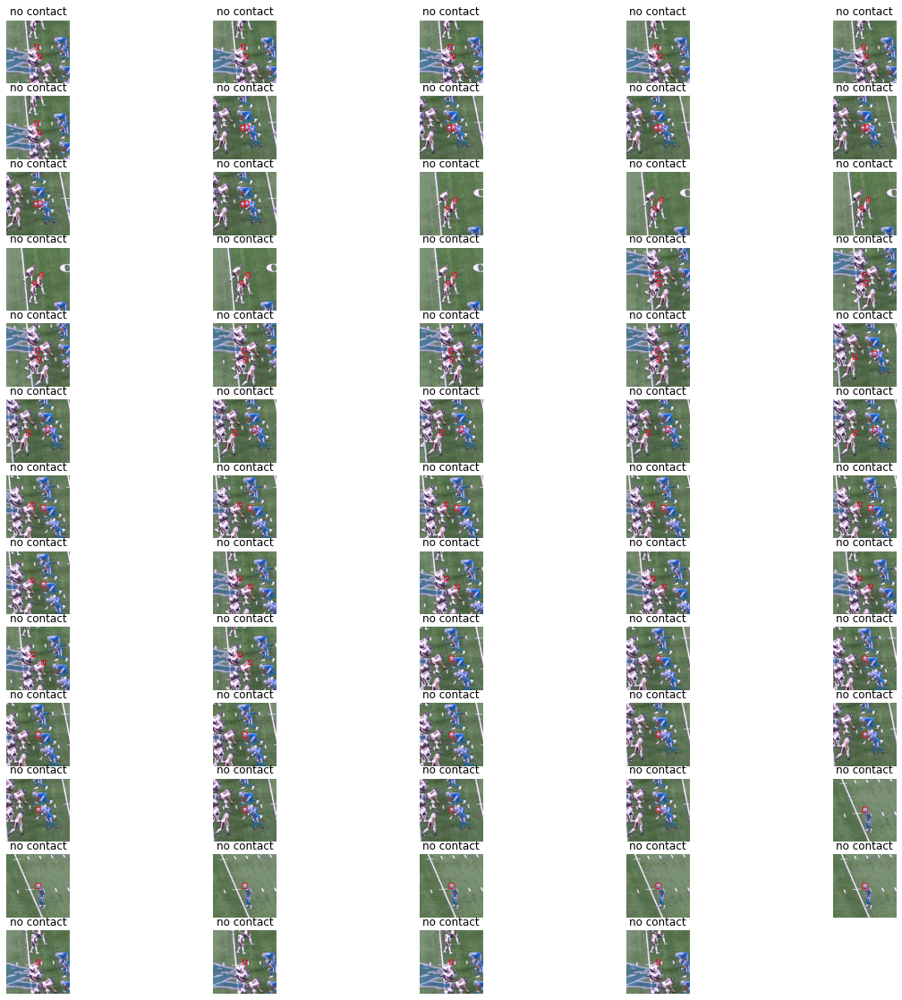

In [35]:
b = next(iter(test_loader))

visualize_batch(b, means, stds)

In [36]:
preds, _, losses = learn.get_preds(dl=test_loader, with_loss=True)

In [41]:
val_df['contact_pred'] = preds[:, 1]
val_df['loss'] = losses

val_df.to_csv(f'{name}.csv', index=False)

### Where does the model fail in terms of frames?

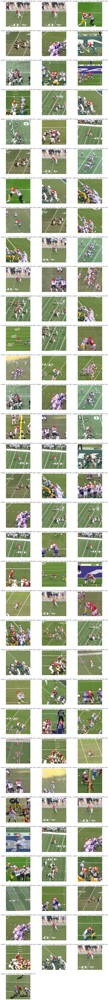

In [64]:
# plot top 100 losses - player to player
n = 100
cols = 3
every_n_frame = 6
plt_df = val_df.sort_values('loss', ascending=False).query('(290 - frame) % @every_n_frame == 0 and nfl_player_id_2 != "G"').iloc[:n]

plt.figure(figsize=(20, plt_df.shape[0]//10*20))        

for i, row in enumerate(plt_df.itertuples()):
    frame = _get_frame(row.path)
    frame = add_helmets(frame, row)
    frame = crop_frame(frame, row.center_x, row.center_y, 256)
    label = ['no contact', 'contact'][row.contact]
    pred = ['no contact', 'contact'][row.contact_pred > 0.5]
    contact_type = ['player', 'ground'][row.nfl_player_id_2 == "G"]
    
    plt.subplot(plt_df.shape[0] // cols + 1, cols, i + 1)
    plt.imshow(frame)
    plt.title(f'{label} | {pred} | {row.contact_pred:.2f} | {contact_type} | {row.loss:.2f} | {row.game_play} | {row.frame}')
    plt.axis("off")

In [68]:
val_df.query('game_play == "58543_000962" and frame == 554').iloc[:, :10]

,contact_id,game_play,datetime,step,nfl_player_id_1,nfl_player_id_2,contact,x_position_1,y_position_1,x_position_2
1107625,58543_000962_43_43641_52457,58543_000962,2021-09-26 17:41:02+00:00,43,43641,52457,1,47.71,34.92,48.63
1096566,58543_000962_43_46146_G,58543_000962,2021-09-26 17:41:02+00:00,43,46146,G,0,41.60,29.33,NaN
1107663,58543_000962_43_53516_G,58543_000962,2021-09-26 17:41:02+00:00,43,53516,G,0,40.88,30.86,NaN
1096483,58543_000962_43_43455_53516,58543_000962,2021-09-26 17:41:02+00:00,43,43455,53516,0,40.68,29.77,40.88
1096519,58543_000962_43_52457_G,58543_000962,2021-09-26 17:41:02+00:00,43,52457,G,0,48.63,34.65,NaN
...,...,...,...,...,...,...,...,...,...,...
1096525,58543_000962_43_48145_G,58543_000962,2021-09-26 17:41:02+00:00,43,48145,G,0,37.18,30.96,NaN
1107607,58543_000962_43_43455_52543,58543_000962,2021-09-26 17:41:02+00:00,43,43455,52543,0,40.68,29.77,40.65
1107723,58543_000962_43_52515_G,58543_000962,2021-09-26 17:41:02+00:00,43,52515,G,0,48.48,33.25,NaN
1107681,58543_000962_43_44877_G,58543_000962,2021-09-26 17:41:02+00:00,43,44877,G,0,36.18,27.26,NaN


In [70]:
val_df.query('game_play == "58543_000962" and nfl_player_id_2 == "52457"').iloc[:, -20:]

,frame,player_label_1,left_1,width_1,top_1,height_1,player_label_2,left_2,width_2,top_2,height_2,top,left,bottom,right,center_y,center_x,path,contact_pred,loss
1094734,507,V21,603.0,7.0,262.0,9.0,H11,602.0,8.0,262.0,10.0,262.0,602.0,272.0,610.0,267.0,606.0,frames/content/work/frames/train/58543_000962_Sideline.mp4_0507.jpg,0.001655,6.404000
1094979,514,V21,607.0,7.0,268.0,7.0,None,NaN,NaN,NaN,NaN,268.0,607.0,275.0,614.0,271.0,610.0,frames/content/work/frames/train/58543_000962_Sideline.mp4_0514.jpg,0.001761,6.341607
1095666,533,V21,602.0,7.0,279.0,9.0,None,NaN,NaN,NaN,NaN,279.0,602.0,288.0,609.0,283.0,605.0,frames/content/work/frames/train/58543_000962_Sideline.mp4_0533.jpg,0.001875,6.279221
1107625,554,V21,611.0,20.0,267.0,22.0,None,NaN,NaN,NaN,NaN,267.0,611.0,289.0,631.0,278.0,621.0,frames/content/work/frames/train/58543_000962_Endzone.mp4_0554.jpg,0.001961,6.234385
1107624,553,V21,608.0,19.0,266.0,21.0,None,NaN,NaN,NaN,NaN,266.0,608.0,287.0,627.0,276.0,617.0,frames/content/work/frames/train/58543_000962_Endzone.mp4_0553.jpg,0.001992,6.218791
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1095879,537,V21,600.0,8.0,278.0,9.0,H11,606.0,8.0,280.0,8.0,278.0,600.0,288.0,614.0,283.0,607.0,frames/content/work/frames/train/58543_000962_Sideline.mp4_0537.jpg,0.991636,0.008399
1095878,536,V21,601.0,8.0,278.0,9.0,H11,605.0,9.0,281.0,10.0,278.0,601.0,291.0,614.0,284.0,607.0,frames/content/work/frames/train/58543_000962_Sideline.mp4_0536.jpg,0.992467,0.007562
1093621,476,V21,625.0,8.0,247.0,8.0,H11,614.0,9.0,246.0,9.0,246.0,614.0,255.0,633.0,250.0,623.0,frames/content/work/frames/train/58543_000962_Sideline.mp4_0476.jpg,0.992611,0.007416
1104336,445,V21,55.0,24.0,90.0,30.0,H11,155.0,26.0,88.0,32.0,88.0,55.0,120.0,181.0,104.0,118.0,frames/content/work/frames/train/58543_000962_Endzone.mp4_0445.jpg,0.005980,0.005998


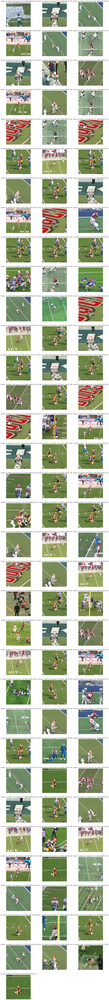

In [71]:
# plot top 100 losses - player to ground
n = 100
cols = 3
every_n_frame = 6
plt_df = val_df.sort_values('loss', ascending=False).query('(290 - frame) % @every_n_frame == 0 and nfl_player_id_2 == "G"').iloc[:n]

plt.figure(figsize=(20, plt_df.shape[0]//10*20))        

for i, row in enumerate(plt_df.itertuples()):
    frame = _get_frame(row.path)
    frame = add_helmets(frame, row)
    frame = crop_frame(frame, row.center_x, row.center_y, 256)
    label = ['no contact', 'contact'][row.contact]
    pred = ['no contact', 'contact'][row.contact_pred > 0.5]
    contact_type = ['player', 'ground'][row.nfl_player_id_2 == "G"]
    
    plt.subplot(plt_df.shape[0] // cols + 1, cols, i + 1)
    plt.imshow(frame)
    plt.title(f'{label} | {pred} | {row.contact_pred:.2f} | {contact_type} | {row.loss:.2f} | {row.game_play} | {row.frame}')
    plt.axis("off")

1. Player to ground contact seems to be highly dependent on movement context, while player to player can be easily guessed without much of movement context
2. I need to understand how the model is behaving with each of these respectly

In [82]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, matthews_corrcoef

### Player to Player confusion matrix

0.5341323275369643


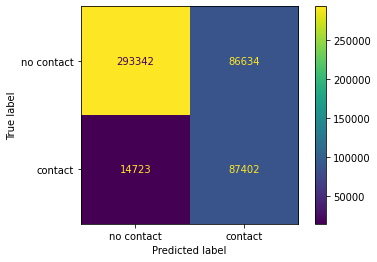

In [93]:
tmp_df = val_df.query('nfl_player_id_2 != "G"').copy()
cm = confusion_matrix(tmp_df['contact'], (tmp_df['contact_pred'] > 0.5).astype(int), labels=[0, 1])
print(matthews_corrcoef(tmp_df['contact'], (tmp_df['contact_pred'] > 0.5).astype(int)))

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['no contact', 'contact'])
disp.plot();

Alot of false positives there, let's analyze them.

In [100]:
tmp_df['is_fp'] = (tmp_df['contact'] == 0) & (tmp_df['contact_pred'] > 0.5)
tmp_df.query('is_fp').view.value_counts(normalize=True)

Sideline    0.583097
Endzone     0.416903
Name: view, dtype: float64

58% of false positives are in Sideline view

In [101]:
tmp_df['player_2_null'] = tmp_df['left_2'].isna()
tmp_df.query('is_fp').player_2_null.value_counts(normalize=True)

False    0.962486
True     0.037514
Name: player_2_null, dtype: float64

And it isn't because directly because of the bounding box of second player.

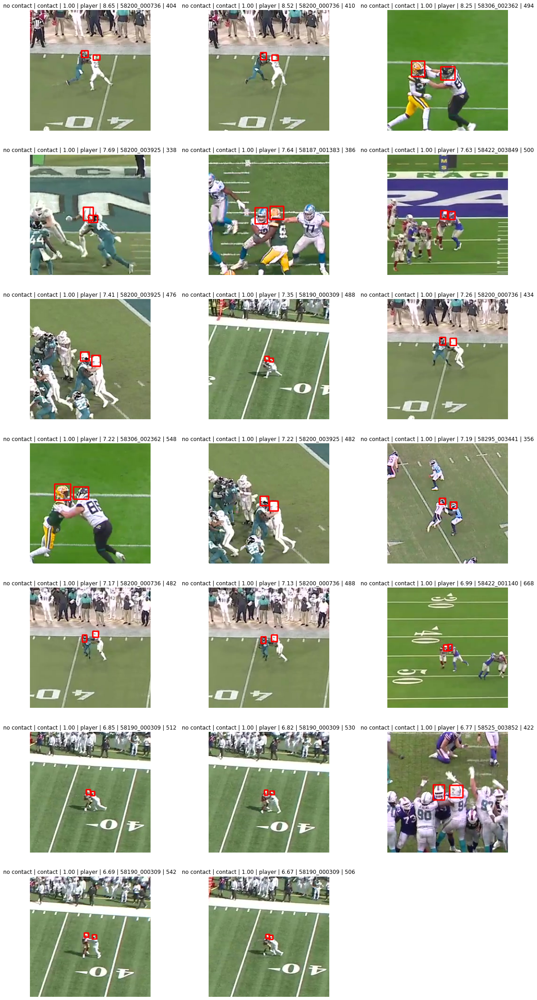

In [102]:
# plot top 100 losses
n = 20
cols = 3
every_n_frame = 6
plt_df = tmp_df.sort_values('loss', ascending=False).query('(290 - frame) % @every_n_frame == 0 and is_fp').iloc[:n]

plt.figure(figsize=(20, plt_df.shape[0]//10*20))        

for i, row in enumerate(plt_df.itertuples()):
    frame = _get_frame(row.path)
    frame = add_helmets(frame, row)
    frame = crop_frame(frame, row.center_x, row.center_y, 256)
    label = ['no contact', 'contact'][row.contact]
    pred = ['no contact', 'contact'][row.contact_pred > 0.5]
    contact_type = ['player', 'ground'][row.nfl_player_id_2 == "G"]
    
    plt.subplot(plt_df.shape[0] // cols + 1, cols, i + 1)
    plt.imshow(frame)
    plt.title(f'{label} | {pred} | {row.contact_pred:.2f} | {contact_type} | {row.loss:.2f} | {row.game_play} | {row.frame}')
    plt.axis("off")

What happends if I average all frames per step?

In [122]:
agg_dict = {col: 'first' for col in val_df.columns}
agg_dict['contact_pred'] = 'mean'
agg_dict['loss'] = 'mean'

tmp_df = val_df.query('nfl_player_id_2 != "G"').groupby('contact_id').agg(agg_dict)

0.5901905133404262


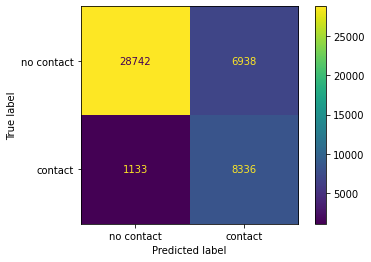

In [123]:
cm = confusion_matrix(tmp_df['contact'], (tmp_df['contact_pred'] > 0.5).astype(int), labels=[0, 1])
print(matthews_corrcoef(tmp_df['contact'], (tmp_df['contact_pred'] > 0.5).astype(int)))

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['no contact', 'contact'])
disp.plot();

In [126]:
tmp_df['is_fp'] = (tmp_df['contact'] == 0) & (tmp_df['contact_pred'] > 0.5)

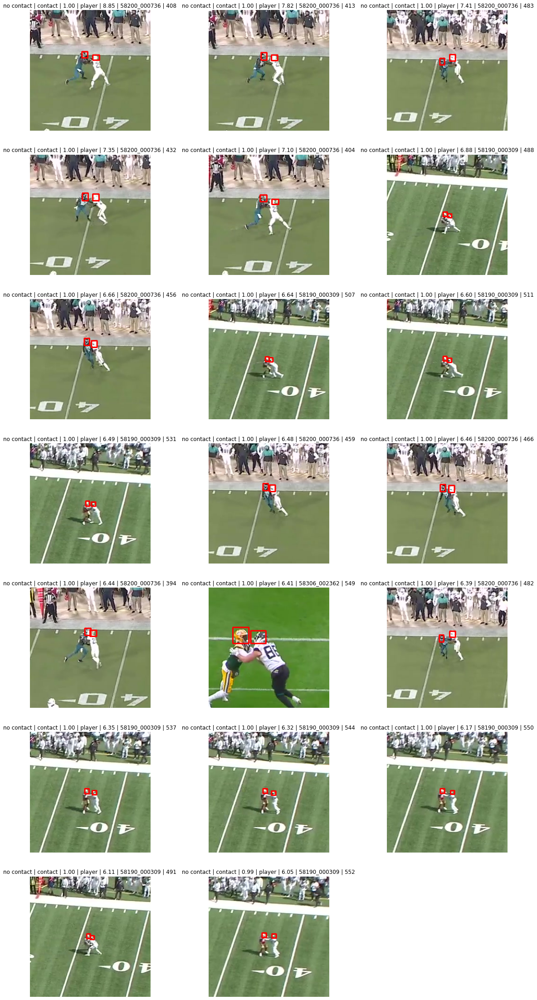

In [127]:
# plot top 100 losses
n = 20
cols = 3
every_n_frame = 6
plt_df = tmp_df.sort_values('loss', ascending=False).query('is_fp').iloc[:n]

plt.figure(figsize=(20, plt_df.shape[0]//10*20))        

for i, row in enumerate(plt_df.itertuples()):
    frame = _get_frame(row.path)
    frame = add_helmets(frame, row)
    frame = crop_frame(frame, row.center_x, row.center_y, 256)
    label = ['no contact', 'contact'][row.contact]
    pred = ['no contact', 'contact'][row.contact_pred > 0.5]
    contact_type = ['player', 'ground'][row.nfl_player_id_2 == "G"]
    
    plt.subplot(plt_df.shape[0] // cols + 1, cols, i + 1)
    plt.imshow(frame)
    plt.title(f'{label} | {pred} | {row.contact_pred:.2f} | {contact_type} | {row.loss:.2f} | {row.game_play} | {row.frame}')
    plt.axis("off")

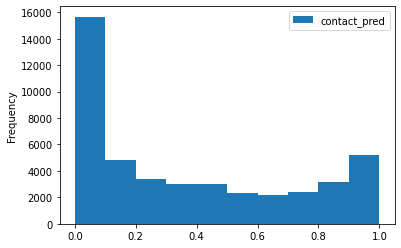

In [131]:
tmp_df.plot(kind='hist', y='contact_pred');

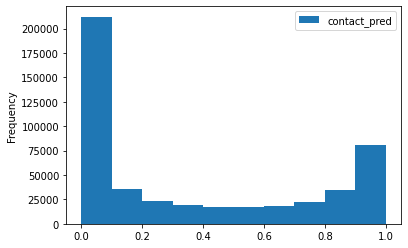

In [133]:
val_df.query('nfl_player_id_2 != "G"').plot(kind='hist', y='contact_pred');

What is the variance across predictions within step?

<AxesSubplot:ylabel='Frequency'>

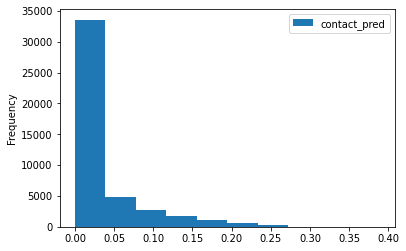

In [135]:
val_df.query('nfl_player_id_2 != "G"').groupby('contact_id').agg({'contact_pred': 'var'}).plot(kind='hist', y='contact_pred')

<AxesSubplot:xlabel='contact', ylabel='contact_pred'>

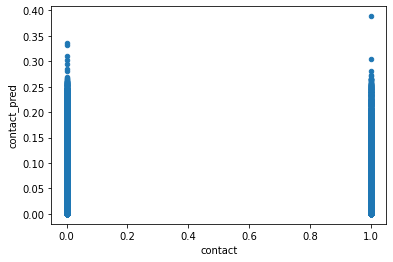

In [139]:
val_df.query('nfl_player_id_2 != "G"').groupby('contact_id').agg({'contact_pred': 'var', 'contact': 'first'}).plot(kind='scatter', x='contact', y='contact_pred')

What effect does smoothing before and after averaging have?

In [240]:
def smooth_predictions(val_df, center, ws):
    val_df_new = pd.DataFrame()
    for group, group_df in tqdm(val_df.groupby(['game_play', 'nfl_player_id_1', 'nfl_player_id_2', 'view'])):
        group_df = group_df.sort_values('frame')
        for w in ws: 
            group_df[f'contact_pred_rolling_{w}'] = group_df.contact_pred.rolling(w, center=center).mean().bfill().ffill().fillna(0)
        val_df_new = pd.concat([val_df_new, group_df])
    return val_df_new

In [241]:
tmp_df = val_df.query('nfl_player_id_2 != "G"').copy()
tmp_df = tmp_df[(tmp_df.left_2.notnull()) | (tmp_df.nfl_player_id_2 == "G")]
tmp_df = smooth_predictions(tmp_df, center=True, ws=np.arange(3, 62, 3))

  0%|          | 0/4349 [00:00<?, ?it/s]

In [242]:
cols = tmp_df.columns[tmp_df.columns.str.contains('rolling')]

cols_results = []

for col in tqdm(cols):
        
    for t in np.linspace(0.3, 0.7, 30):
        
        result = {}
    
        result['col'] = col
        
        result['thresh'] = t

        result['full'] = matthews_corrcoef(tmp_df["contact"], (tmp_df[col] > t).astype(int))

        agg_dict = {col: 'first' for col in val_df.columns}
        agg_dict[col] = 'mean'

        tmp_df_2 = tmp_df.groupby('contact_id').agg(agg_dict)

        result['average'] = matthews_corrcoef(tmp_df_2["contact"], (tmp_df_2[col] > t).astype(int))

        cols_results.append(result)

  0%|          | 0/20 [00:00<?, ?it/s]

In [243]:
pd.DataFrame(cols_results).sort_values('average', ascending=False).iloc[:5]

,col,thresh,full,average
299,contact_pred_rolling_30,0.700000,0.618452,0.660550
298,contact_pred_rolling_30,0.686207,0.617529,0.660541
269,contact_pred_rolling_27,0.700000,0.616241,0.660028
268,contact_pred_rolling_27,0.686207,0.615510,0.659672
267,contact_pred_rolling_27,0.672414,0.614961,0.659383


### Player to ground confusion matrix

In [ ]:
tmp_df = val_df.query('nfl_player_id_2 == "G"')
tmp_df = tmp_df[(tmp_df.left_2.notnull()) | (tmp_df.nfl_player_id_2 == "G")]
tmp_df = smooth_predictions(tmp_df, center=True, ws=np.arange(6, 62, 6))

  0%|          | 0/2054 [00:00<?, ?it/s]

In [251]:
cols = tmp_df.columns[tmp_df.columns.str.contains('rolling')]

cols_results = []

for col in tqdm(cols):
        
    for t in np.linspace(0.3, 0.7, 10):
        
        result = {}
    
        result['col'] = col
        
        result['thresh'] = t

        result['full'] = matthews_corrcoef(tmp_df["contact"], (tmp_df[col] > t).astype(int))

        agg_dict = {col: 'first' for col in val_df.columns}
        agg_dict[col] = 'mean'

        tmp_df_2 = tmp_df.groupby('contact_id').agg(agg_dict)

        result['average'] = matthews_corrcoef(tmp_df_2["contact"], (tmp_df_2[col] > t).astype(int))

        cols_results.append(result)

  0%|          | 0/10 [00:00<?, ?it/s]

In [252]:
pd.DataFrame(cols_results).sort_values('average', ascending=False).iloc[:5]

,col,thresh,full,average
94,contact_pred_rolling_60,0.477778,0.768704,0.810522
84,contact_pred_rolling_54,0.477778,0.764590,0.809499
93,contact_pred_rolling_60,0.433333,0.761390,0.808375
74,contact_pred_rolling_48,0.477778,0.761558,0.808049
85,contact_pred_rolling_54,0.522222,0.770282,0.806271


### Now let's test these configs against the best config so far

#### Best config so far

In [17]:
from nflutils.validation import *

In [214]:
def get_matthews_corrcoef(val_dist_agg, pred_col='contact_pred_rolling', thresh=0.5):
    out = np.where(val_dist_agg['contact_pred'].isna(),
                   val_dist_agg['distance'] <= 1, 
                   val_dist_agg[pred_col] > thresh).astype(int)
    
    return matthews_corrcoef(val_dist_agg['contact'], out)

In [224]:
every_n_frame = 6
sub = val_df.query('(290 - frame) % @every_n_frame == 0')
sub = sub[(sub.left_2.notnull()) | (sub.nfl_player_id_2 == "G")]

sub = smooth_predictions(sub, True, ws=[5])
sub = merge_combo_val(df_combo, sub, pred_col='contact_pred_rolling_5')
get_matthews_corrcoef(sub, thresh=0.64, pred_col='contact_pred_rolling_5')

  0%|          | 0/6365 [00:00<?, ?it/s]

0.708660530417308

In [225]:
get_matthews_corrcoef(sub, thresh=0.64, pred_col='contact_pred_rolling_5')

0.708660530417308

#### New config

In [253]:
def merge_combo_val(df_combo, val_df, pred_col='contact_pred_rolling'):
    val_dist = df_combo[df_combo.game_play.isin(val_df.game_play.unique())].copy()

    val_dist["distance"] = val_dist["distance"].fillna(99)  # Fill player to ground with 9    
    val_dist_agg = val_dist.merge(val_df.groupby('contact_id', as_index=False)[pred_col].mean(), how='left', on='contact_id')
    val_dist_agg = val_dist_agg.merge(val_df.groupby('contact_id', as_index=False)['thresh'].first(), how='left', on='contact_id')
    
    if pred_col != 'contact_pred':
        val_dist_agg = val_dist_agg.merge(val_df.groupby('contact_id', as_index=False)['contact_pred'].mean(), how='left', on='contact_id')
        
    return val_dist_agg

In [254]:
def get_matthews_corrcoef(val_dist_agg, pred_col='contact_pred_rolling', thresh=0.5):
    out = np.where(val_dist_agg['contact_pred'].isna(),
                   val_dist_agg['distance'] <= 1, 
                   val_dist_agg[pred_col] > val_dist_agg['thresh']).astype(int)
    
    return matthews_corrcoef(val_dist_agg['contact'], out)

In [255]:
sub = val_df.copy()
# sub = sub[(sub.left_2.notnull()) | (sub.nfl_player_id_2 == "G")]

sub = smooth_predictions(sub, True, ws=[60, 27])
sub['contact_pred_rolling'] = np.where(sub.nfl_player_id_2.notnull(), sub.contact_pred_rolling_30, sub.contact_pred_rolling_60)
sub['thresh'] = np.where(sub.nfl_player_id_2.notnull(), 0.7, 0.477778)

  0%|          | 0/6432 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [233]:
sub = merge_combo_val(df_combo, sub, pred_col='contact_pred_rolling')
get_matthews_corrcoef(sub, thresh=0.64, pred_col='contact_pred_rolling')

0.7049466567040585

In [ ]:
sub = val_df.copy()
sub = sub[(sub.left_2.notnull()) | (sub.nfl_player_id_2 == "G")]

sub = smooth_predictions(sub, True, ws=[60, 30])
sub['contact_pred_rolling'] = np.where(sub.nfl_player_id_2.notnull(), sub.contact_pred_rolling_30, sub.contact_pred_rolling_60)
sub['thresh'] = np.where(sub.nfl_player_id_2.notnull(), 0.7, 0.477778)

  0%|          | 0/6403 [00:00<?, ?it/s]

In [ ]:
sub = merge_combo_val(df_combo, sub, pred_col='contact_pred_rolling')
get_matthews_corrcoef(sub, thresh=0.64, pred_col='contact_pred_rolling')

In [23]:
ss_dist_with_helmets.loc[:, 'contact_pred'] = preds
sub = smooth_predictions(ss_dist_with_helmets, 5, True)

sub = merge_combo_val(ss_dist, sub, pred_col='contact_pred_rolling')
get_matthews_corrcoef(sub, thresh=0.64)

  0%|          | 0/6387 [00:00<?, ?it/s]

0.622131250930468

In [39]:
# sub = merge_combo_val(ss_dist, ss_dist_with_helmets, pred_col='contact_pred')
get_matthews_corrcoef(sub, 'contact_pred', thresh=0.5)

0.5442237424483249

In [89]:
CrossEntropyLossFlat().activation(b_preds)[:, 1]

TensorBase([0.8243, 0.9998, 0.8619, 0.5144, 0.0265, 0.3219, 0.1865, 0.0143,
            0.8952, 0.6173, 0.9670, 0.5498, 0.4759, 0.4306, 0.7658, 0.5277,
            0.2801, 0.4688, 0.1494, 0.0135, 0.2278, 0.2613, 0.1136, 0.0869,
            0.0189, 0.2730, 0.4799, 0.1554, 0.5281, 0.7334, 1.0000, 0.4886,
            0.0051, 0.1719, 0.2445, 0.0079, 0.7587, 0.3798, 0.9220, 0.5039,
            0.2831, 0.2511, 0.4462, 0.6241, 0.2708, 0.1491, 0.1376, 0.0049,
            0.5442, 0.1110, 0.0669, 0.0628, 0.0263, 0.1514, 0.2537, 0.0285,
            0.8105, 0.7189, 0.9997, 0.6782, 0.0244, 0.1750, 0.2179, 0.0345],
           device='cuda:0')

In [81]:
rgb_bbox_1.contact_pred.head()

0    0.020216
1    0.712532
2    0.034326
3    0.011812
4    0.000615
Name: contact_pred, dtype: float64

In [50]:
sub.head()

,contact_id,game_play,step,nfl_player_id_1,nfl_player_id_2,contact,datetime,x_position_1,y_position_1,x_position_2,y_position_2,distance,contact_pred
0,58173_003606_0_46183_52475,58173_003606,0,46183,52475,0,2020-09-13 19:45:12.500000+00:00,67.58,23.63,67.74,20.93,2.704737,NaN
1,58173_003606_0_46183_47864,58173_003606,0,46183,47864,0,2020-09-13 19:45:12.500000+00:00,67.58,23.63,80.34,20.12,13.233960,NaN
2,58173_003606_0_46183_47929,58173_003606,0,46183,47929,0,2020-09-13 19:45:12.500000+00:00,67.58,23.63,74.00,34.04,12.230474,NaN
3,58173_003606_0_46183_47826,58173_003606,0,46183,47826,0,2020-09-13 19:45:12.500000+00:00,67.58,23.63,67.83,26.80,3.179843,NaN
4,58173_003606_0_46183_52581,58173_003606,0,46183,52581,0,2020-09-13 19:45:12.500000+00:00,67.58,23.63,65.84,37.45,13.929106,NaN


In [50]:
ss_dist_with_helmets.shape

(192981, 33)

In [19]:
ss_dist_with_helmets.loc[:, 'contact_pred'] = torch.sigmoid(preds)
sub = smooth_predictions(ss_dist_with_helmets, 5, True)

sub = merge_combo_val(ss_dist, sub, pred_col='contact_pred')
get_matthews_corrcoef(sub, pred_col='contact_pred', thresh=0.5)

0.44488878956935946

In [51]:
# sub = ss.merge(ss_dist_with_helmets[['contact_id', 'contact_pred', 'contact_pred_rolling', 'distance']], how='left', on='contact_id')
# sub['distance'] = sub.distance.fillna(99)

In [34]:
get_matthews_corrcoef(ss_dist, thresh=0.64)

0.708660530417308

In [104]:
test_ds = NFLFrameDataset(ss_dist_with_helmets, transform=val_transform, crop_size=256)

test_loader = DataLoader(
    test_ds, batch_size=bs, shuffle=False, num_workers=8, pin_memory=True,
)

data = DataLoaders(test_loader, test_loader)

# model, model_info = create_timm_model('convnext_tiny', n_out=2, n_in=3)
model = torch.load(CFG.utils_path+f'/{name}.pkl')

learn = Learner(data, model, CrossEntropyLossFlat(), metrics=[accuracy, MatthewsCorrCoef(), Recall(), Precision(), F1Score()],
                cbs=[
                    # WandbCallback(log_preds=False, seed=seed),
                    # SaveModelCallback(monitor='matthews_corrcoef', fname=name)
                ]
               ).to_fp16()

# learn = learn.load(name)


learn.model = learn.model.cuda()

In [106]:
ss_dist_with_helmets.loc[:, 'contact_pred'] = preds[:, 1].cpu().detach().numpy()

In [107]:
sub = smooth_predictions(ss_dist_with_helmets, 5, True)

  0%|          | 0/6387 [00:00<?, ?it/s]

In [ ]:
sub = merge_combo_val(ss_dist, sub, pred_col='contact_pred_rolling')

In [117]:
get_matthews_corrcoef(sub, pred_col='contact_pred_rolling', thresh=0.6)

0.7132943717571135

# Validation Pipeline

In [103]:
from nflutils.validation import *

In [25]:
rgb_bbox_1 = pd.read_csv('rgb-bbox-1.csv')
rgb_bbox_1['contact_pred'] = rgb_bbox_1['preds_1']

In [49]:
rgb_bbox_1.shape

(192981, 36)

In [17]:
rgb_bbox_1 = smooth_predictions(rgb_bbox_1, 5, True)

  0%|          | 0/6365 [00:00<?, ?it/s]

In [22]:
def get_matthews_corrcoef(val_dist_agg, pred_col='contact_pred_rolling', thresh=0.5):
    out = np.where(val_dist_agg['contact_pred'].isna(),
                   val_dist_agg['distance'] <= 1, 
                   val_dist_agg[pred_col] > thresh).astype(int)
    
    return matthews_corrcoef(val_dist_agg['contact'], out)

In [20]:
ss_dist = merge_combo_val(ss_dist, rgb_bbox_1, pred_col='contact_pred_rolling')

In [23]:
get_matthews_corrcoef(ss_dist, thresh=0.64)

0.708660530417308

In [58]:
torch.sigmoid(preds)

tensor([0.5550, 0.9987, 0.5975,  ..., 0.1771, 0.4838, 0.9085])

In [56]:
rgb_bbox_1

,contact_id,game_play,datetime,step,nfl_player_id_1,nfl_player_id_2,contact,x_position_1,y_position_1,x_position_2,...,left,bottom,right,center_y,center_x,is_valid,path,preds_0,preds_1,contact_pred
0,58173_003606_0_41475_46108,58173_003606,2020-09-13 19:45:12.500000+00:00,0,41475,46108,0,65.26,27.27,65.51,...,309.0,389.0,338.0,361.0,323.0,True,frames/content/work/frames/train/58173_003606_Sideline.mp4_0296.jpg,0.979784,0.020216,0.020216
1,58173_003606_0_43330_52475,58173_003606,2020-09-13 19:45:12.500000+00:00,0,43330,52475,0,68.04,19.21,67.74,...,423.0,499.0,457.0,487.0,440.0,True,frames/content/work/frames/train/58173_003606_Sideline.mp4_0296.jpg,0.287468,0.712532,0.712532
2,58173_003606_0_41290_46120,58173_003606,2020-09-13 19:45:12.500000+00:00,0,41290,46120,0,66.33,34.50,65.71,...,301.0,236.0,344.0,210.0,322.0,True,frames/content/work/frames/train/58173_003606_Sideline.mp4_0296.jpg,0.965674,0.034326,0.034326
3,58173_003606_0_38642_43320,58173_003606,2020-09-13 19:45:12.500000+00:00,0,38642,43320,0,65.30,20.71,65.38,...,315.0,488.0,339.0,461.0,327.0,True,frames/content/work/frames/train/58173_003606_Sideline.mp4_0296.jpg,0.988188,0.011812,0.011812
4,58173_003606_0_35534_43330,58173_003606,2020-09-13 19:45:12.500000+00:00,0,35534,43330,0,66.17,18.75,68.04,...,360.0,509.0,457.0,492.0,408.0,True,frames/content/work/frames/train/58173_003606_Sideline.mp4_0296.jpg,0.999385,0.000615,0.000615
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
192976,58581_000040_51_47846_G,58581_000040,2021-10-11 00:22:50+00:00,51,47846,G,0,38.24,23.28,NaN,...,682.0,444.0,696.0,435.0,689.0,True,frames/content/work/frames/train/58581_000040_Endzone.mp4_0602.jpg,0.998306,0.001694,0.001694
192977,58581_000040_51_52596_G,58581_000040,2021-10-11 00:22:50+00:00,51,52596,G,0,59.31,32.87,NaN,...,1187.0,646.0,1196.0,639.0,1191.0,True,frames/content/work/frames/train/58581_000040_Endzone.mp4_0602.jpg,0.983182,0.016818,0.016818
192978,58581_000040_51_42511_G,58581_000040,2021-10-11 00:22:50+00:00,51,42511,G,0,19.72,21.77,NaN,...,652.0,322.0,666.0,314.0,659.0,True,frames/content/work/frames/train/58581_000040_Endzone.mp4_0602.jpg,0.997872,0.002128,0.002128
192979,58581_000040_51_53079_G,58581_000040,2021-10-11 00:22:50+00:00,51,53079,G,0,34.04,8.70,NaN,...,98.0,406.0,113.0,399.0,105.0,True,frames/content/work/frames/train/58581_000040_Endzone.mp4_0602.jpg,0.990366,0.009634,0.009634
